In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn import cluster, datasets
from pandas import DataFrame as df
from IPython.display import clear_output

import datetime

from sklearn.metrics import mean_squared_error
from sklearn.model_selection import learning_curve

import keras
from keras.models import load_model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.layers.core import  Activation, Dropout  
from keras.optimizers import RMSprop
from keras.layers import Embedding, RepeatVector
from keras.layers import LSTM
from keras.layers.recurrent import GRU
from keras.optimizers import SGD
from sklearn.preprocessing import MinMaxScaler

import DailyMLPModel as D
import DailyNNModel as DNN
import DailyNeuralNetworkModel1 as DNNm
from DailyNeuralNetworkModel1 import getWinterForecastingResults

%matplotlib inline
#%matplotlib qt
%config InlineBackend.figure_format = 'retina'

/Users/mac/anaconda/lib/python2.7/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using Theano backend.


In [4]:
def import_data():
    dataset = pd.read_csv('../data/DP.csv',usecols=[27],engine='python')
    return dataset
def mean_absolute_percentage_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

def mean_absolute_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) )) 

def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())


def prepareInputs(daydata, season, UsedInputs,testPeriod):
    nbrInputs= 0
    
    previousHours = UsedInputs[0]
    timeSteps = int(UsedInputs[1])
    previousDay = UsedInputs[2]
    previousWeek = UsedInputs[3]
    temp = UsedInputs[4]
    tempMax = UsedInputs[5]
    tempMin = UsedInputs[6]
    dayIndicator = UsedInputs[7]
    HourIndicator= UsedInputs[8]
    monthIndicator = UsedInputs[9]
    
    if previousHours == True: 
        nbrInputs = nbrInputs + int(timeSteps)
    if previousDay == True: nbrInputs= nbrInputs+1
    if previousWeek == True : nbrInputs= nbrInputs+ 1
    if temp == True: nbrInputs= nbrInputs+1
    if tempMax == True: nbrInputs= nbrInputs+1
    if tempMin == True: nbrInputs= nbrInputs+1
    if dayIndicator== True: nbrInputs= nbrInputs+7
    if HourIndicator== True : nbrInputs= nbrInputs+24
    if monthIndicator== True : nbrInputs= nbrInputs + 12
    
    
    hourclusters= np.empty([(daydata.index.size*24),1])

    hourdataindex= pd.DataFrame(index=pd.date_range('2014-1-8 00:00:00', periods=(365)*24, freq='H'))

    for x in range(0,daydata.index.size):
        for y in range(0,24):
            hourclusters[(x * 24) + y,0] = daydata.iloc[x,24]
    hourclusters.size

    tempAlgiers=  pd.read_csv('../data/tempAlgiers.csv')
    tempA= tempAlgiers.loc[:,'Hour_1':'Hour_24']
    tempnp= np.array(tempA)
    tempnp= tempnp.reshape(-1,1)
    tempdata= pd.DataFrame(tempnp)

    tempmax= tempAlgiers.loc[:,'Tmax']
    tempmin= tempAlgiers.loc[:,'Tmin']




    tempmx= np.random.random([tempmax.size*24,1])
    tempmn= np.random.random([tempmin.size*24,1])



    for x in range(0,tempmax.size):
        for y in range(0,24):
            tempmx[(x * 24) + y,0] = tempmax.iloc[x]

    for x in range(0,tempmin.size):
        for y in range(0,24):
            tempmn[(x * 24) + y,0] = tempmin.iloc[x]
        

    samples = daydata.index.size*24
    daydata2= daydata.copy()
    del(daydata2['cluster'])

    data= pd.DataFrame(np.array(daydata2).reshape(-1,1))

    maxcons= data.values.max()
    mincons= data.values.min()

    maxtemp= np.max(tempdata.values)
    mintemp= tempdata.values.min()

    maxtempmax= np.max(tempmx)
    mintempmax= np.min(tempmx)

    maxtempmin= np.max(tempmn)
    mintempmin= np.min(tempmn)

    sigxx= np.empty((samples - 168 , nbrInputs))
    sigyy= np.empty((samples - 168 , 1))

    i= 0
    for x in list(range(168,samples)):
        i=0
        if previousHours == True: 
            for y in list(range(timeSteps)):
                sigxx[x - 168 , i] = (data.iloc[x - i - 1 , 0])/(2*maxcons)
                i= i + 1
        if previousDay == True: 
            sigxx[x - 168 , i] = (data.iloc[x - 24 , 0])/(2*maxcons)
            i= i+1
        if previousWeek == True : 
            sigxx[x - 168 , i] = (data.iloc[x - 168 , 0])/(2*maxcons)
            i= i+ 1
        if temp == True: 
            sigxx[x - 168 , i] = (tempdata.iloc[x])/(2*maxtemp)
            i= i+1
        if tempMax == True: 
            sigxx[x - 168 , i] = (tempmx[x]) / (2 * maxtempmax)
            i= i+1
        if tempMin == True: 
            sigxx[x - 168 , i] = (tempmn[x]) / (2 * maxtempmin)
            i= i+1
        if dayIndicator == True:
            ind=0
            for y in range(0,7):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + pd.datetime.weekday(hourdataindex.index[x])]=1
            i = i + 7
        if HourIndicator == True:
            ind=0
            for y in range(0,24):
                sigxx[x - 168 , i+ind]= 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].hour]=1
            i = i + 24
        if monthIndicator == True:
            ind=0
            for y in range(0,12):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].month - 1]=1
            i = i + 12 
    
    for x in list(range(168,samples)):
        sigyy[x - 168 , 0]= (data.iloc[x , 0])/(2*maxcons)

    sigmoidxx= df(sigxx.copy())
    sigmoidyy= df(sigyy.copy())

    sigmoidxx.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')
    sigmoidyy.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')

    sigmoidxx['cluster'] = hourclusters[168:]
    sigmoidyy['cluster'] = hourclusters[168:]
    dfhourclusters = df(hourclusters)
    
    SigmoidInputs =sigmoidxx[sigmoidxx.cluster==season].copy()
    
    SigmoidOutputs= sigmoidyy[sigmoidyy.cluster==SigmoidInputs.loc[SigmoidInputs.index[0],'cluster']]
    del(SigmoidInputs['cluster'],SigmoidOutputs['cluster'])
    learningoutputs = pd.DataFrame(SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testoutputs = pd.DataFrame(SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    learninginputs = pd.DataFrame(SigmoidInputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testinputs = pd.DataFrame(SigmoidInputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    print('-------Input preparation process complet-------')
    return learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs

In [14]:
data = import_data()
data= np.array(data)
data= data.reshape(-1,24)

daydata= df(data)
daydata.index= pd.date_range('2014-1-1', periods=365, freq='D')

clusters= np.loadtxt('../data/Mixed_4_Clusters',delimiter=',')

pca= PCA(n_components=3)
pca.fit(daydata)
data_pca =  pca.transform(daydata)

# pdClusters= pd.DataFrame(clusters,index=daydata.index)
print(clusters)



# fig = plt.figure(1, figsize=(12, 9))

# ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=45, azim=135)

# dayofweek = pd.DatetimeIndex(daydata.index).dayofweek

# ax.scatter(data_pca[:,0],data_pca[:,1],data_pca[:,2],cmap=plt.cm.spectral,c=clusters,alpha= 0.4)

# plt.show()


daydata['cluster']=clusters

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0.
 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 4. 4. 4. 1.
 1. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3.
 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 4. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 4. 4. 2. 1. 1. 4. 1.
 1. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

In [15]:
testPeriod= 480

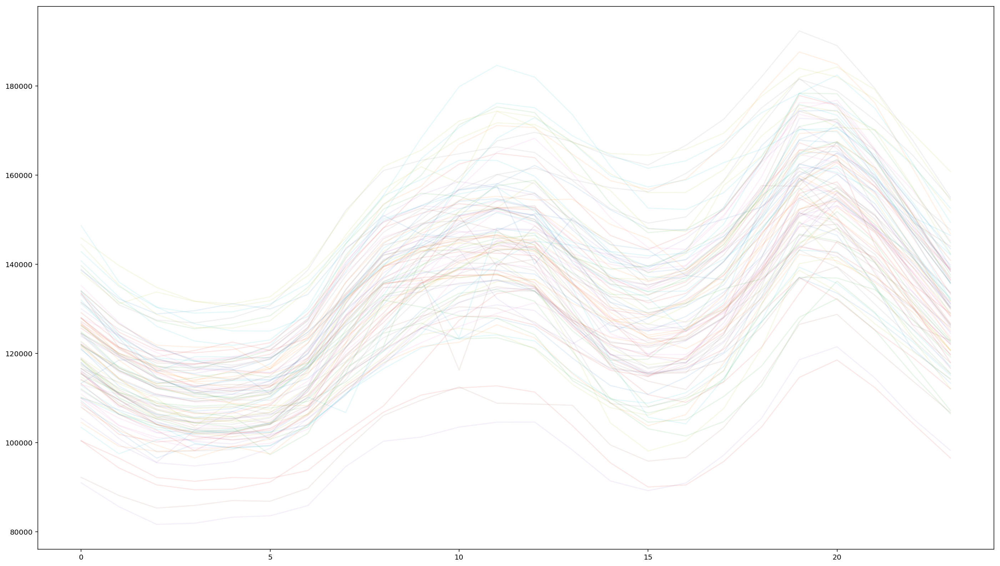

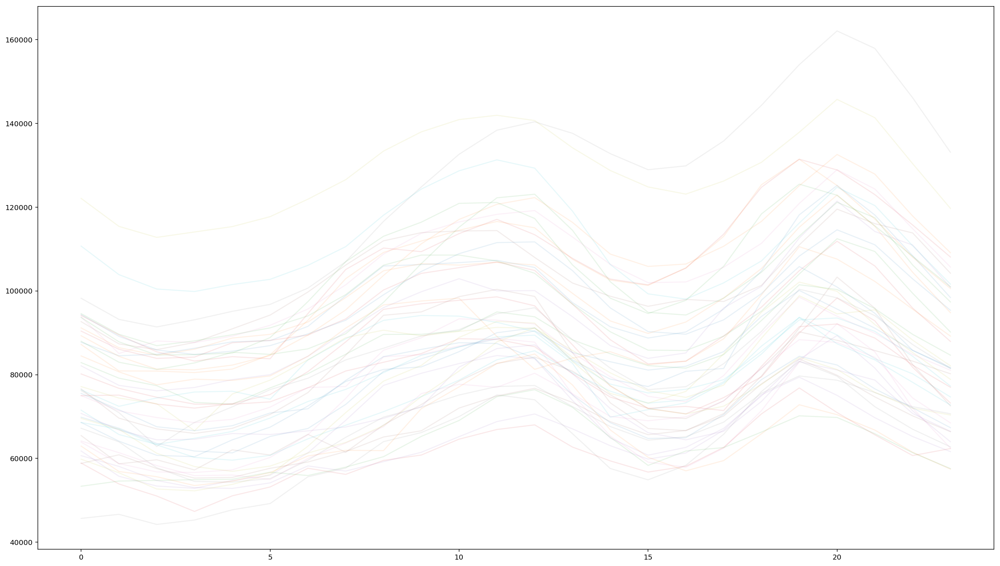

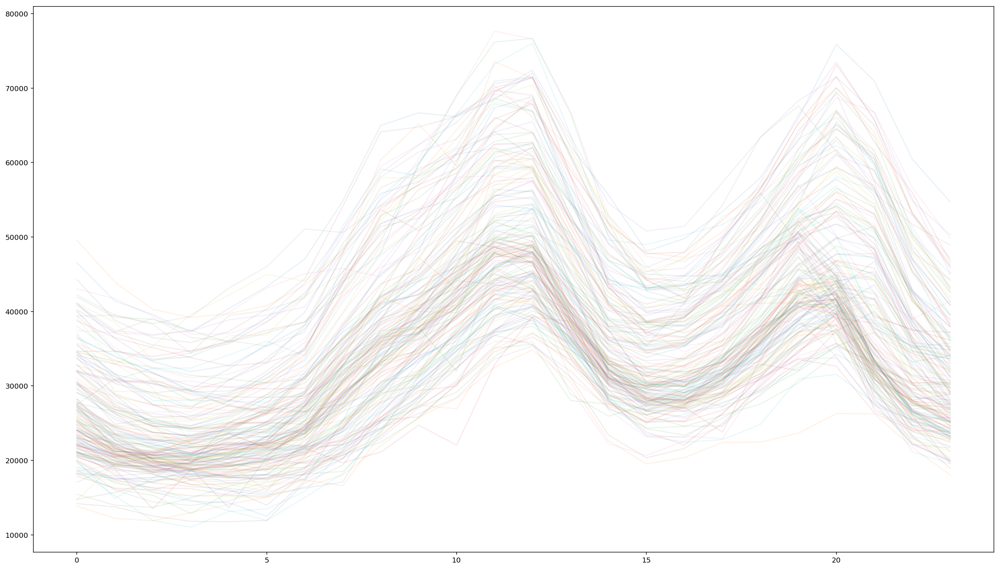

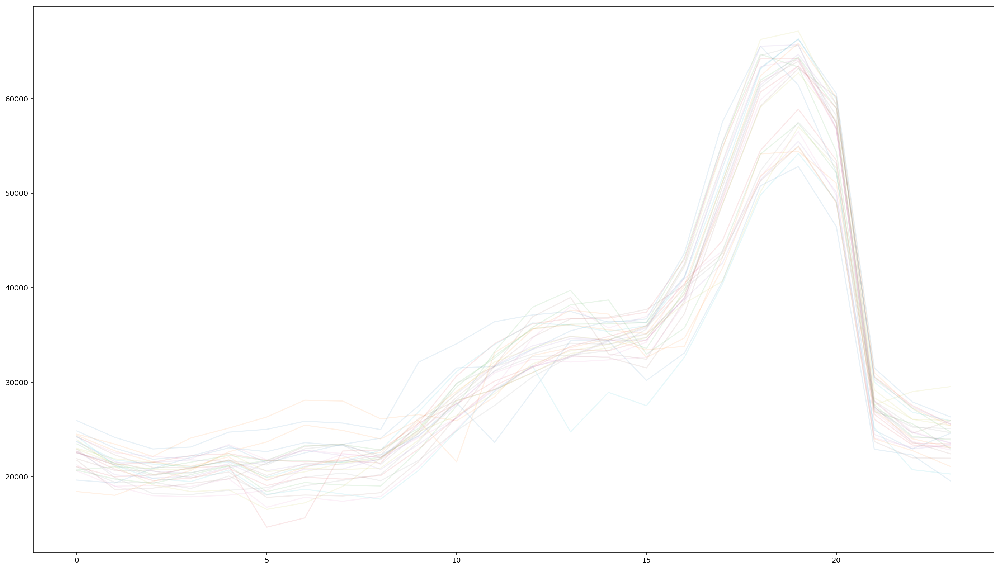

In [16]:

temp=daydata.copy()
del(temp['cluster'])

plt.figsize=(24,14)
temp[daydata.cluster==0].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==1].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==2].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==3].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)


plt.show()

In [17]:
def create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,n_features,HiddenNeurons1=None,HiddenNeurons2=None
                              ,LearningRate=None,Epoch=None,Optimizer=None, timeSteps= None):
    
    if HiddenNeurons1 is None: HiddenNeurons1 = 10
    if HiddenNeurons2 is None: HiddenNeurons2 = 5
    if LearningRate is None: LearningRate = 0.001
    if Epoch is None: Epoch = 500
    if Optimizer is None: Opitimizer = 'Adam'
    if timeSteps is None: timeSteps = 1
        
    mlpmodel = Sequential()
    # Dense(64) is a fully-connected layer with 64 hidden units.
    # in the first layer, you must specify the expected input data shape:
    # here, 20-dimensional vectors.
    mlpmodel.add(LSTM(units= HiddenNeurons1, return_sequences=True, activation='sigmoid', input_shape=(timeSteps, n_features)))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(LSTM(units= HiddenNeurons2, activation='sigmoid', return_sequences=False))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(Dense(1, init='uniform',activation='sigmoid'))
    mlpmodel.compile(optimizer=Optimizer, loss='mse')
#     mlpmodel.add(Dense(HiddenNeurons1, input_dim=inputx1.shape[1],activation='sigmoid'))
#     mlpmodel.add(Dense(HiddenNeurons2, init='uniform'))
#     mlpmodel.add(Dense(1, init='uniform'))
#     mlpmodel.add(Activation('sigmoid'))

#     sgd = SGD(lr=LearningRate, decay=1e-6, momentum=0.9, nesterov=True)
#     mlpmodel.compile(loss='mse', optimizer=Optimizer)

    tempMLPmodels= np.empty((Epoch),dtype=object)
    tempErrorHistory= np.empty((Epoch),dtype=object)

    counter=0
    for i in range(0,Epoch):
        print('epoch:   %d .' %counter)
        ErrorHistory= mlpmodel.fit(x=inputx1.reshape(-1,1,n_features), y=outputx1, epochs=1,batch_size=12
                                   ,validation_data=(inputx2.reshape(-1,1,n_features),outputx2),verbose= 2)
        tempMLPmodels[i]= mlpmodel
        mlpmodel.save('temp/lstm_%d_%s'%(i,season))
        tempErrorHistory[i]=ErrorHistory.history['val_loss']
        counter = counter +1    
    print('==============================================================================')
    print('\t \t LSTM model is ready for forecasting')
    print('==============================================================================')
    
    
    return tempMLPmodels, tempErrorHistory, mlpmodel

def getForecastingResults(tempMLPmodels, tempErrorHistory, learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

#     arg= tempErrorHistory.argmin()
#     Model = load_model('temp/lstm_%d_%s'%(arg,season))
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0]
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
    
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

In [18]:
season = 2
Epoch = 3000


UsedInputList = []
ModelsList = []
MAPErrorList = []
ForecastingList = []
Models_IDs = []
Models_parameters = []
Model_ID = 0
today = datetime.date.today()


	 	 test num : 0
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.75672691206 
Daily Learning mean absolute percentage error of 158 days : 5.40669301567 
	 	 MAPError plot through Learning DataSet 


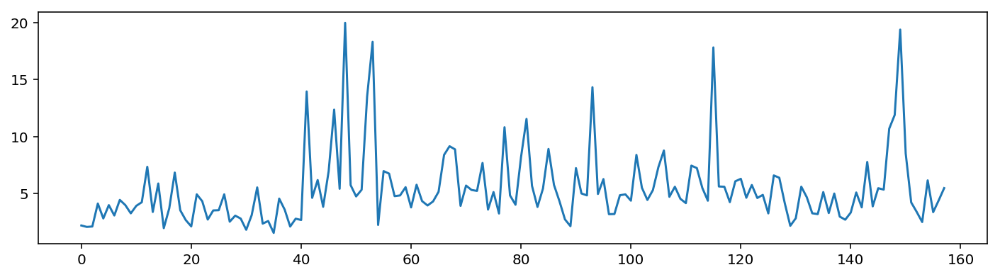

	 	 Test subset results
Test mean absolute percentage error per hour: 3.379023
Test mean absolute percentage error per day: 9.333912 
	 	 Validation Forecasting visualisation


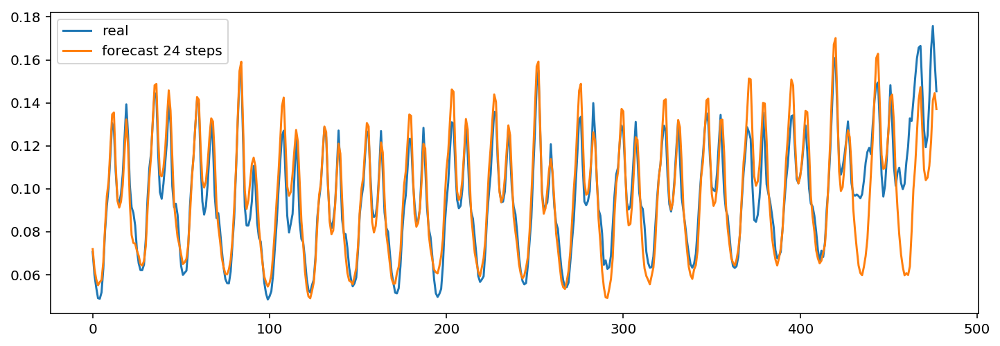

	 	 Forecasting a sample from Learning dataset


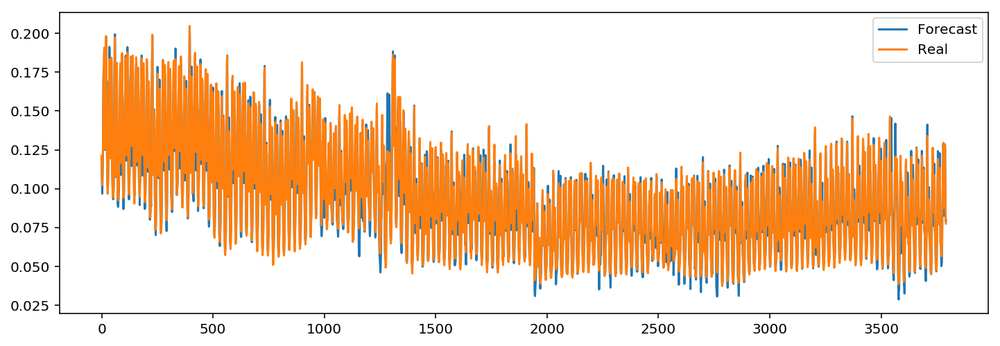

In [12]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 24
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 1
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.92294914226 
Daily Learning mean absolute percentage error of 158 days : 5.98891905516 
	 	 MAPError plot through Learning DataSet 


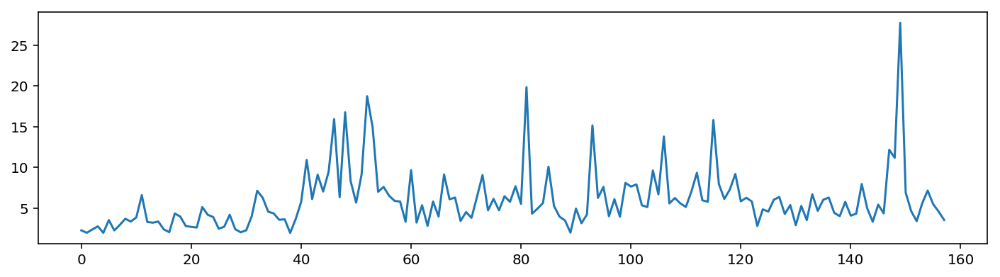

	 	 Test subset results
Test mean absolute percentage error per hour: 3.298572
Test mean absolute percentage error per day: 6.716752 
	 	 Validation Forecasting visualisation


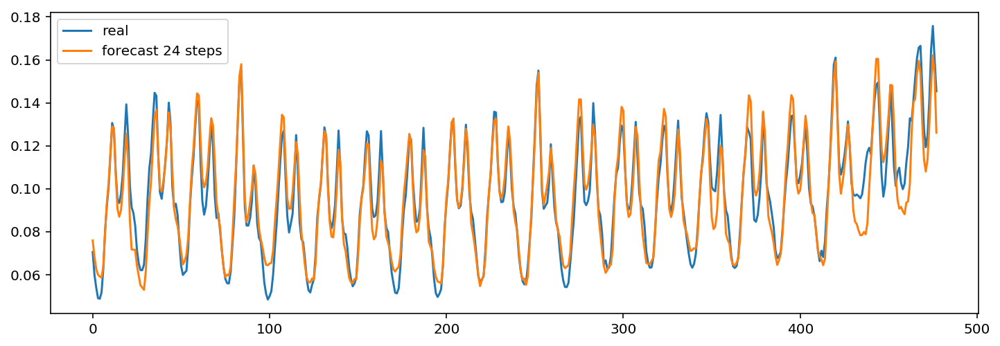

	 	 Forecasting a sample from Learning dataset


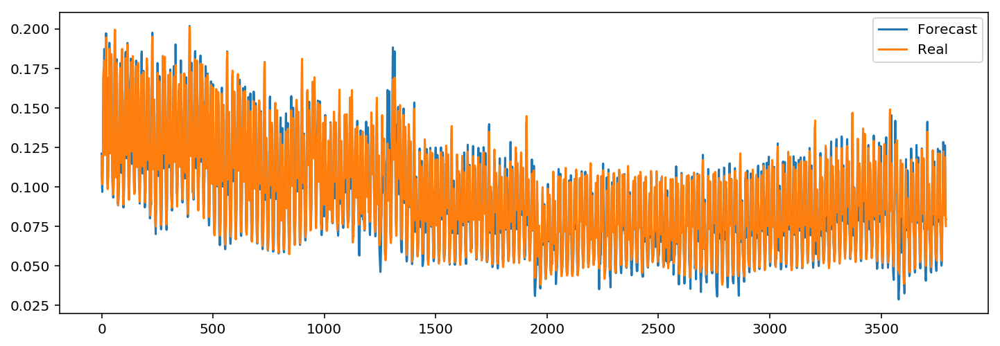

In [13]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 2
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.0007702432 
Daily Learning mean absolute percentage error of 158 days : 6.01565622152 
	 	 MAPError plot through Learning DataSet 


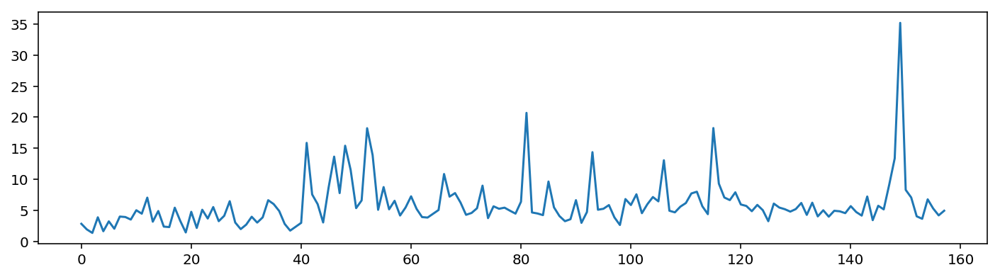

	 	 Test subset results
Test mean absolute percentage error per hour: 3.238372
Test mean absolute percentage error per day: 7.068640 
	 	 Validation Forecasting visualisation


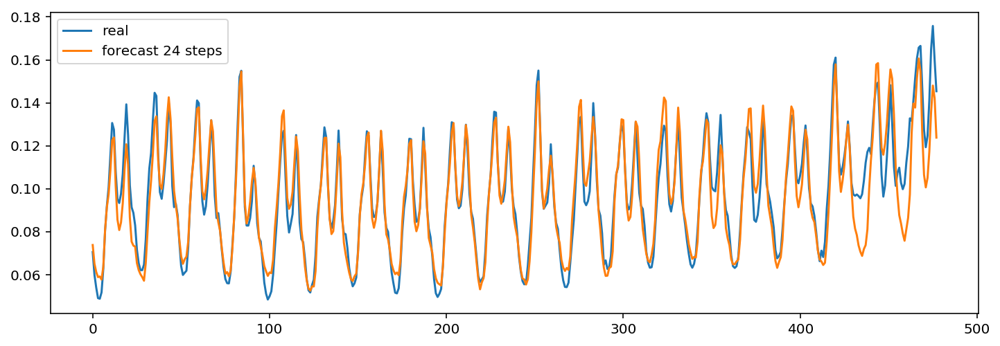

	 	 Forecasting a sample from Learning dataset


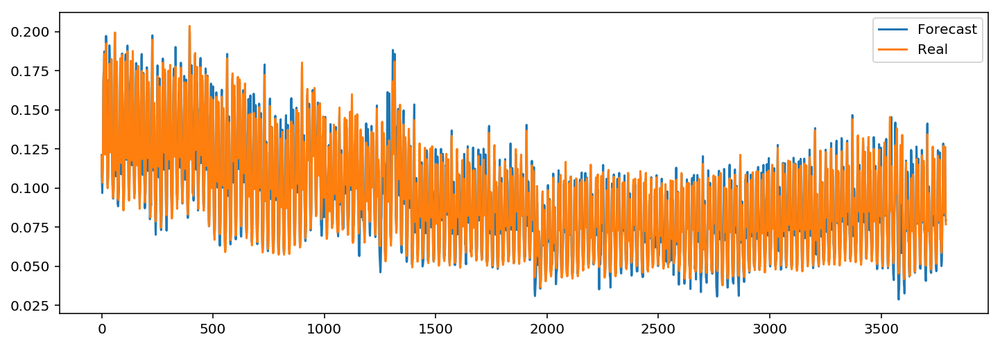

In [14]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 3
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.96880728905 
Daily Learning mean absolute percentage error of 158 days : 5.91326640829 
	 	 MAPError plot through Learning DataSet 


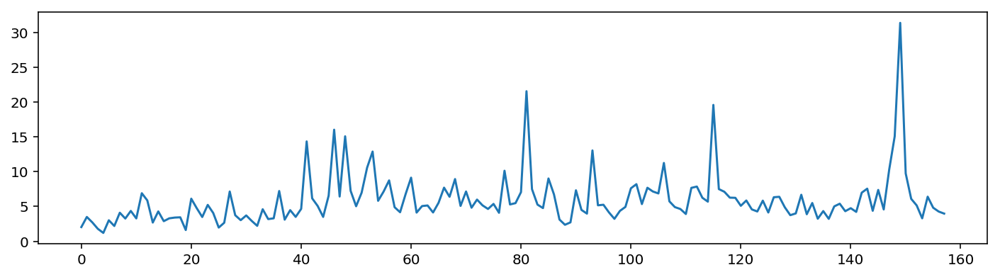

	 	 Test subset results
Test mean absolute percentage error per hour: 3.369647
Test mean absolute percentage error per day: 8.665655 
	 	 Validation Forecasting visualisation


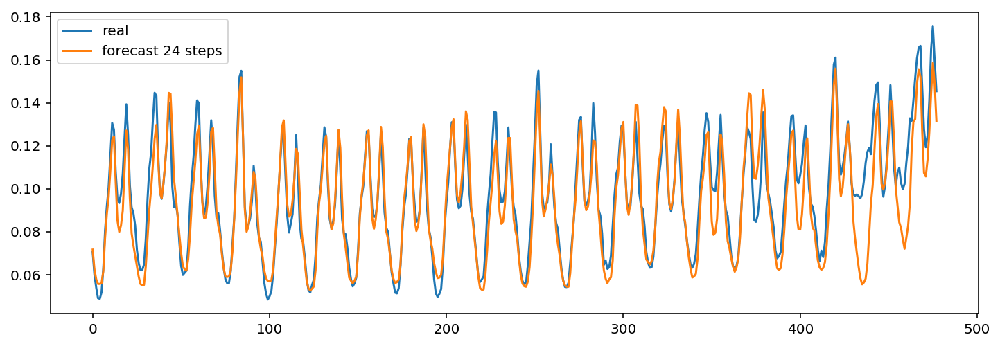

	 	 Forecasting a sample from Learning dataset


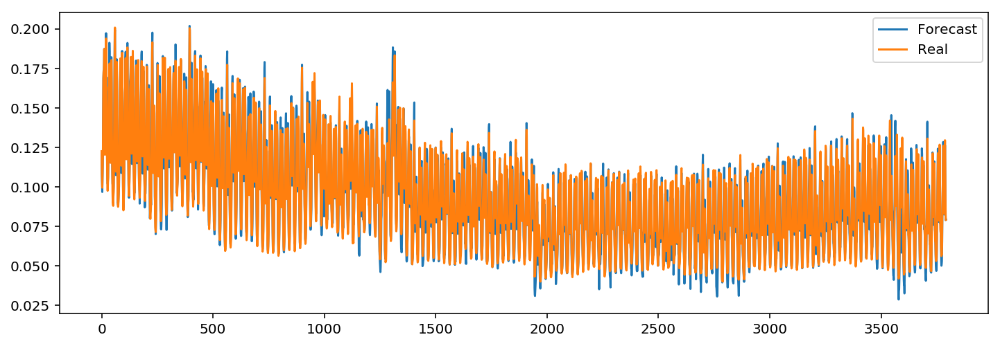

In [15]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 4
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.98158764182 
Daily Learning mean absolute percentage error of 158 days : 6.12428325415 
	 	 MAPError plot through Learning DataSet 


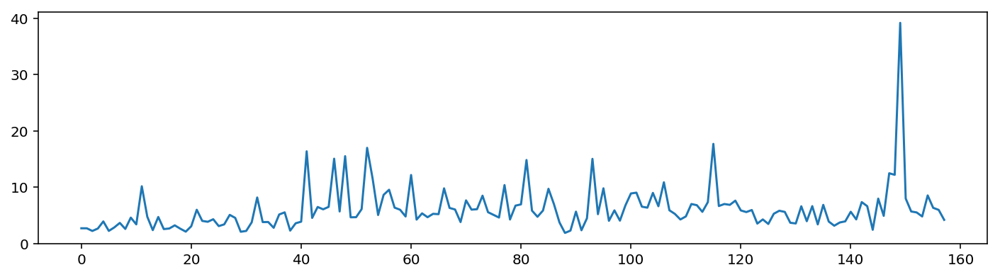

	 	 Test subset results
Test mean absolute percentage error per hour: 3.587186
Test mean absolute percentage error per day: 6.826152 
	 	 Validation Forecasting visualisation


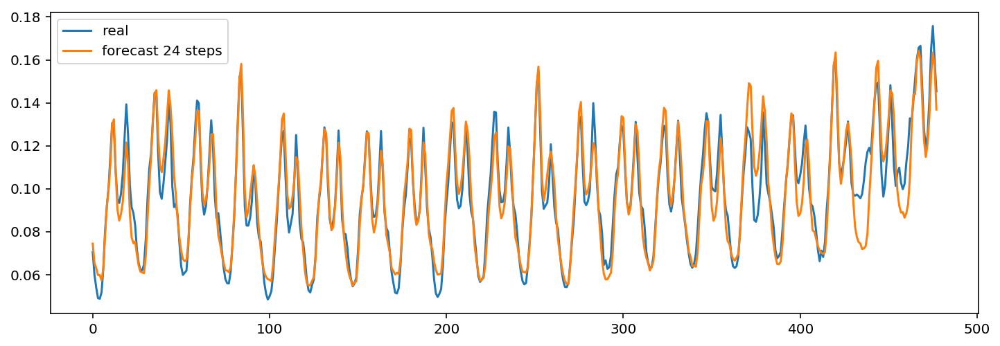

	 	 Forecasting a sample from Learning dataset


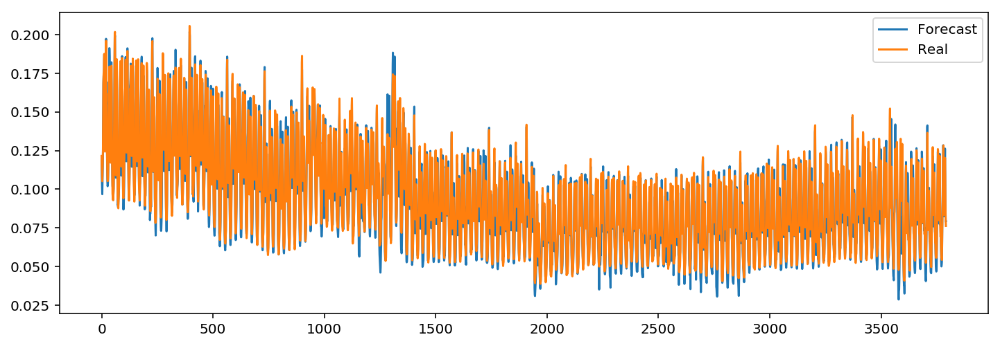

In [16]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 5
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.01856721558 
Daily Learning mean absolute percentage error of 158 days : 6.51996139786 
	 	 MAPError plot through Learning DataSet 


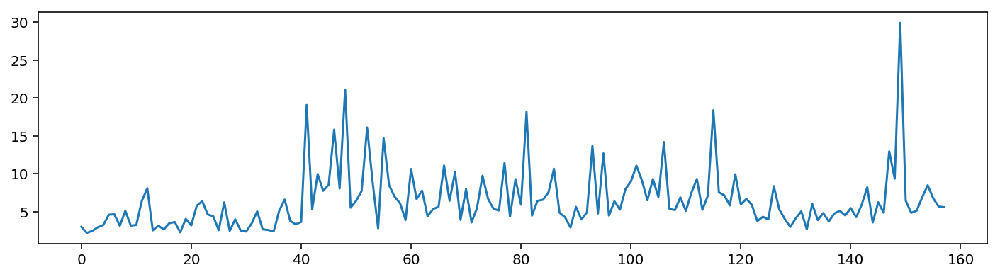

	 	 Test subset results
Test mean absolute percentage error per hour: 3.493431
Test mean absolute percentage error per day: 7.324167 
	 	 Validation Forecasting visualisation


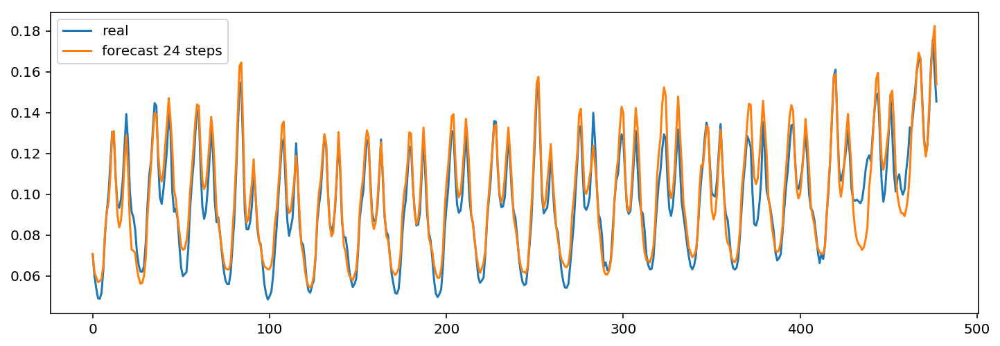

	 	 Forecasting a sample from Learning dataset


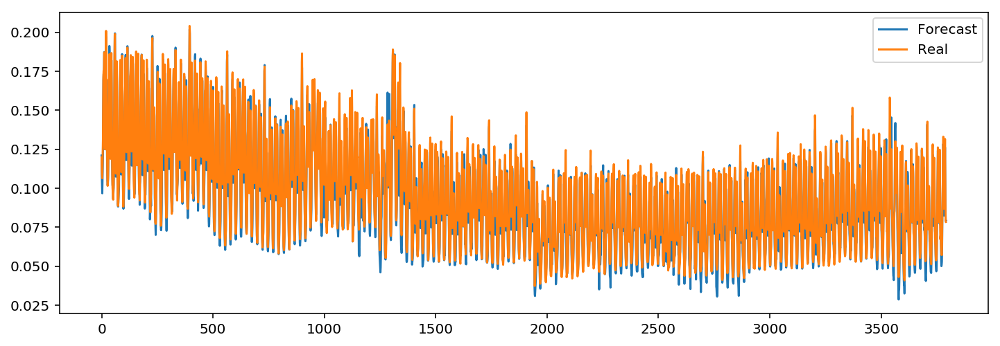

In [17]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 6
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.91486084656 
Daily Learning mean absolute percentage error of 158 days : 5.57264599619 
	 	 MAPError plot through Learning DataSet 


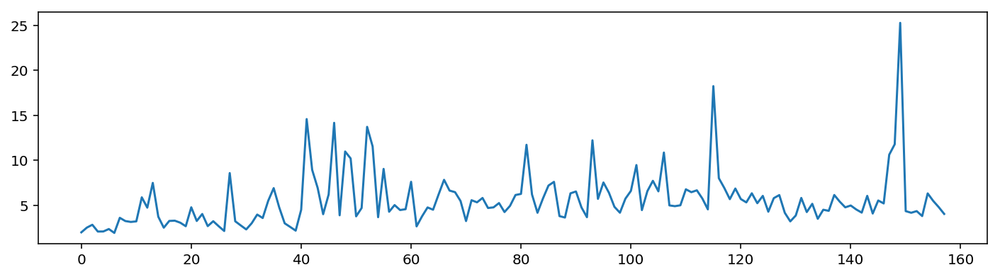

	 	 Test subset results
Test mean absolute percentage error per hour: 3.648321
Test mean absolute percentage error per day: 7.126138 
	 	 Validation Forecasting visualisation


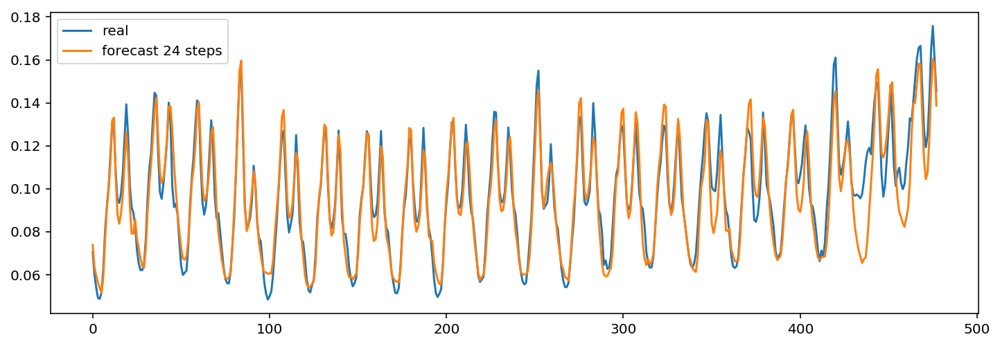

	 	 Forecasting a sample from Learning dataset


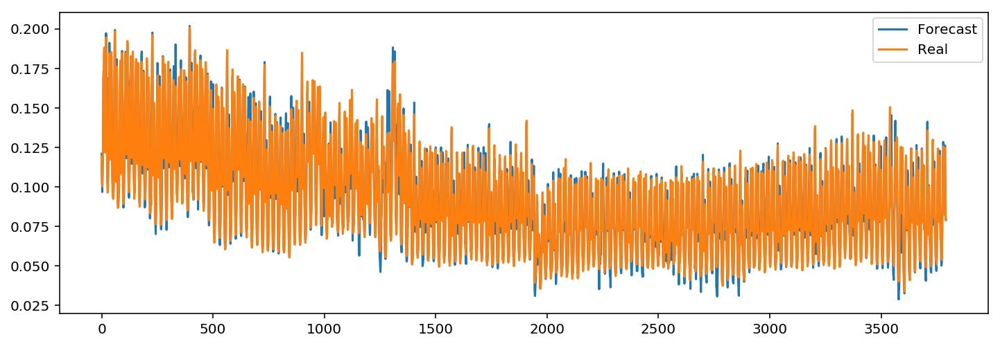

In [18]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 50
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 7
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.94775680932 
Daily Learning mean absolute percentage error of 158 days : 5.88584477615 
	 	 MAPError plot through Learning DataSet 


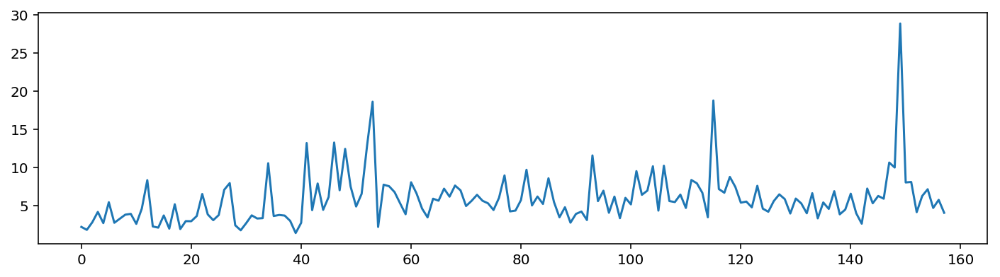

	 	 Test subset results
Test mean absolute percentage error per hour: 3.459873
Test mean absolute percentage error per day: 7.510287 
	 	 Validation Forecasting visualisation


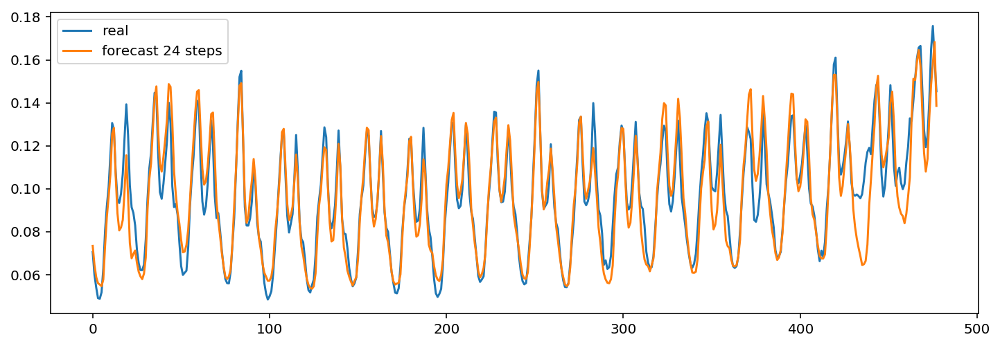

	 	 Forecasting a sample from Learning dataset


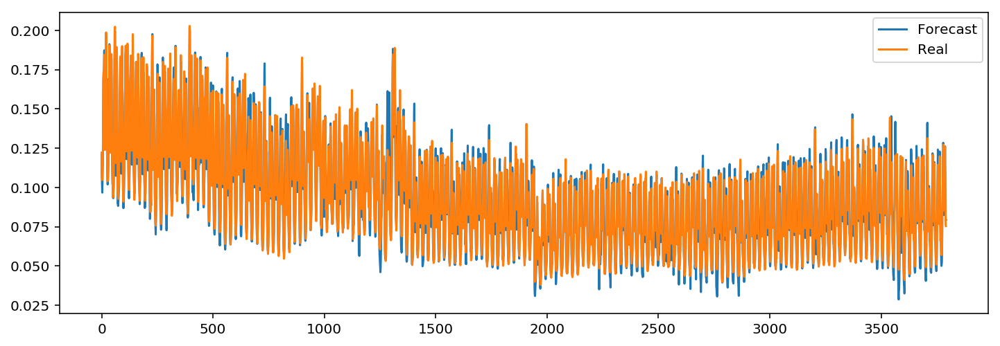

In [19]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 80
Parameters[1]= HiddenNeurons2 = 50
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 8
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.02773499614 
Daily Learning mean absolute percentage error of 158 days : 6.72221235988 
	 	 MAPError plot through Learning DataSet 


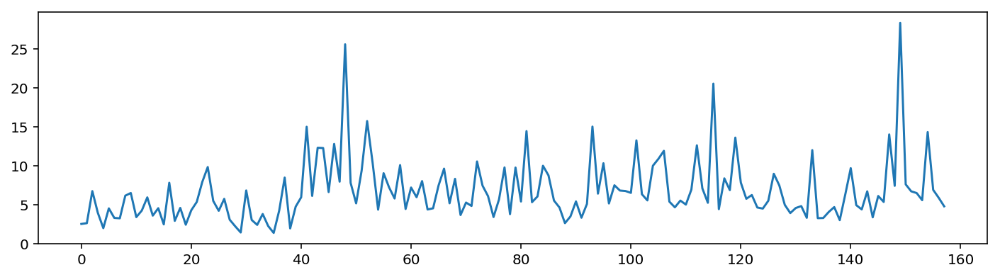

	 	 Test subset results
Test mean absolute percentage error per hour: 3.271328
Test mean absolute percentage error per day: 7.715700 
	 	 Validation Forecasting visualisation


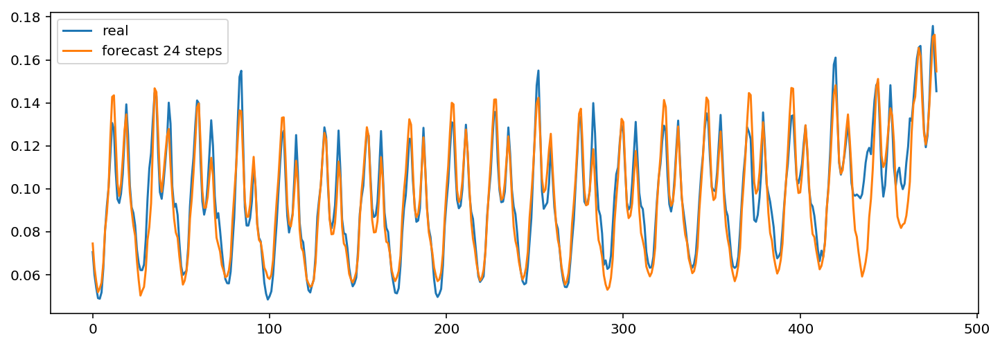

	 	 Forecasting a sample from Learning dataset


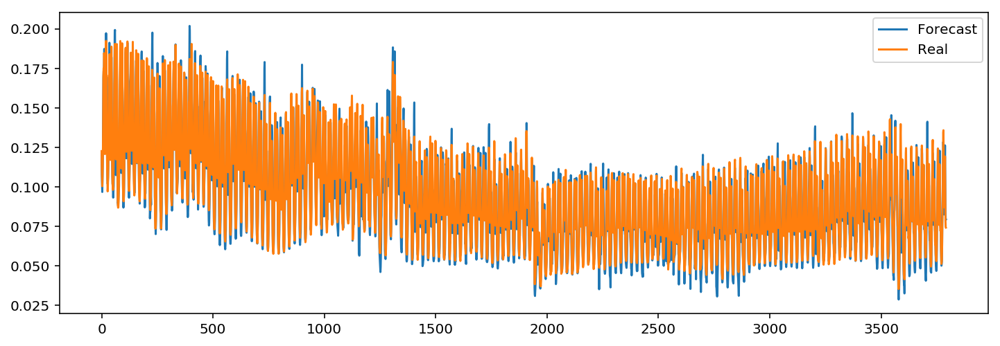

In [20]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()
MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 9
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.75092010336 
Daily Learning mean absolute percentage error of 158 days : 7.87173719798 
	 	 MAPError plot through Learning DataSet 


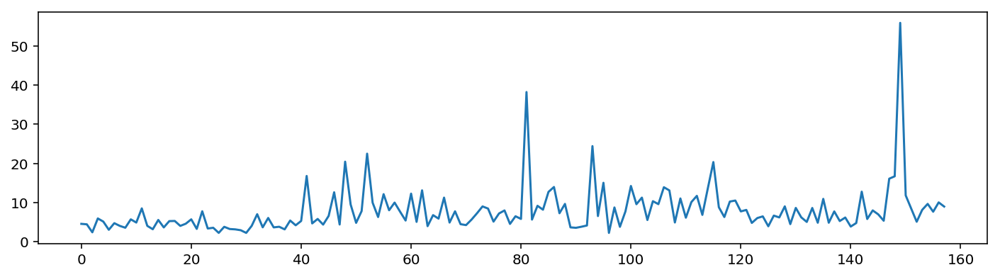

	 	 Test subset results
Test mean absolute percentage error per hour: 3.629780
Test mean absolute percentage error per day: 7.132482 
	 	 Validation Forecasting visualisation


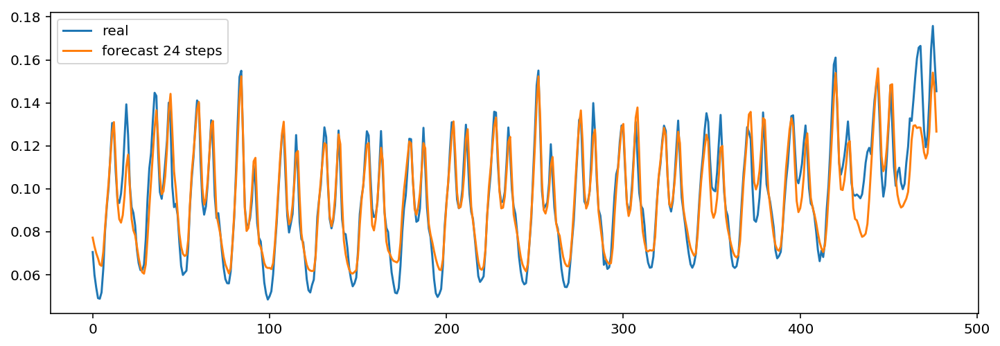

	 	 Forecasting a sample from Learning dataset


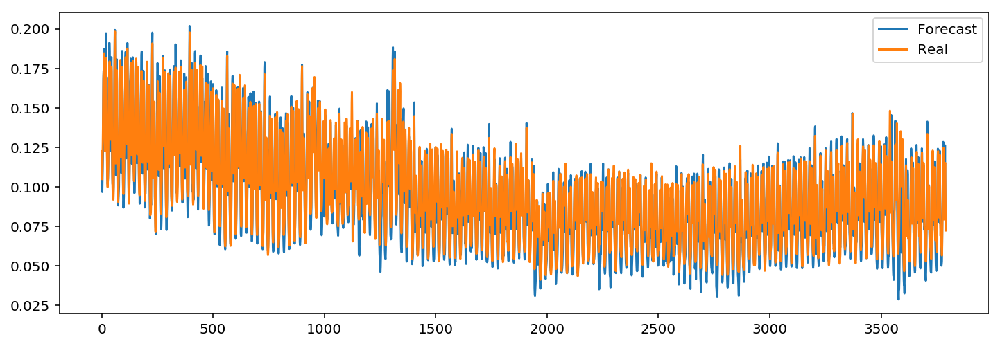

In [21]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 10
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.69855018185 
Daily Learning mean absolute percentage error of 158 days : 8.08881981463 
	 	 MAPError plot through Learning DataSet 


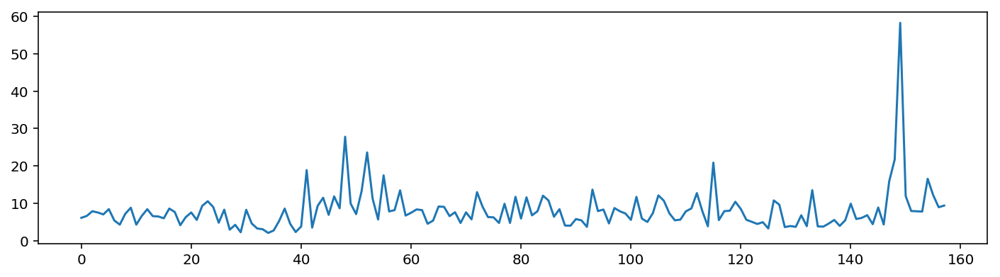

	 	 Test subset results
Test mean absolute percentage error per hour: 3.762883
Test mean absolute percentage error per day: 28.108088 
	 	 Validation Forecasting visualisation


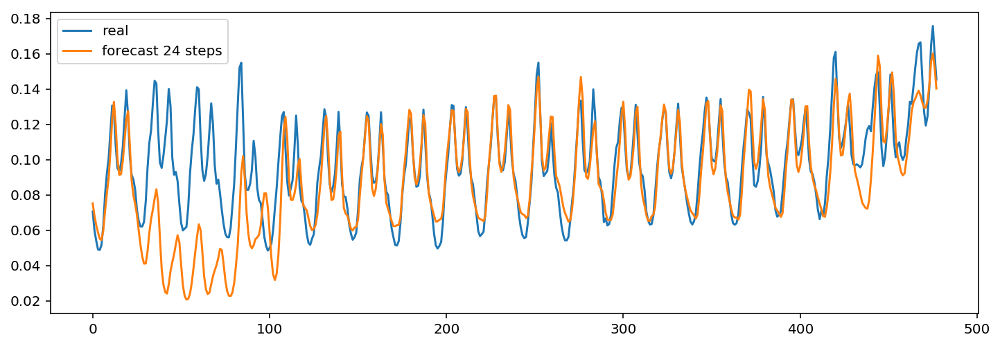

	 	 Forecasting a sample from Learning dataset


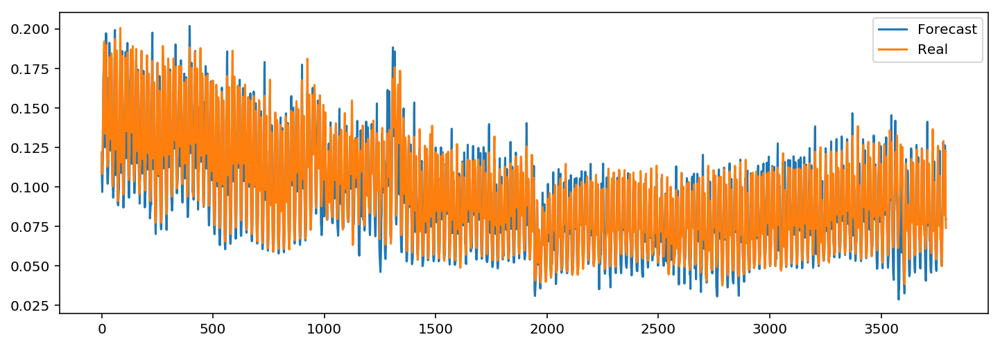

In [22]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()
MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 11
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.01087235612 
Daily Learning mean absolute percentage error of 158 days : 6.21676405925 
	 	 MAPError plot through Learning DataSet 


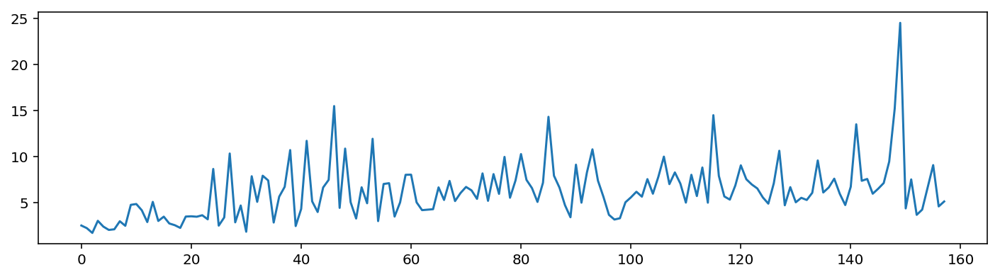

	 	 Test subset results
Test mean absolute percentage error per hour: 3.439875
Test mean absolute percentage error per day: 9.557974 
	 	 Validation Forecasting visualisation


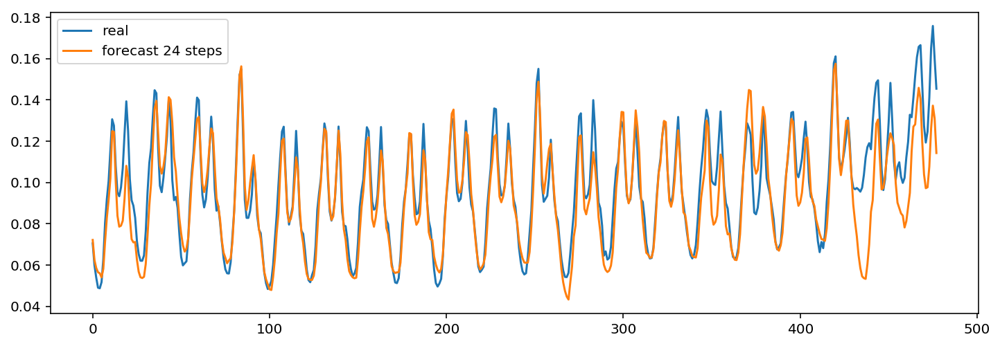

	 	 Forecasting a sample from Learning dataset


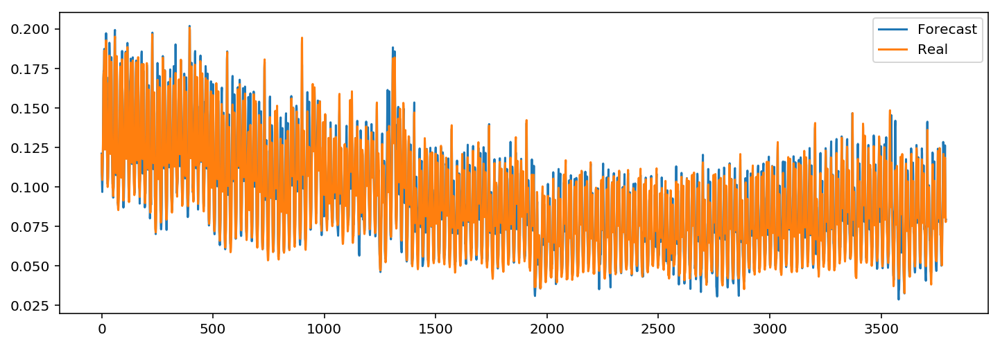

In [23]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 12
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.21589642771 
Daily Learning mean absolute percentage error of 158 days : 6.41133270837 
	 	 MAPError plot through Learning DataSet 


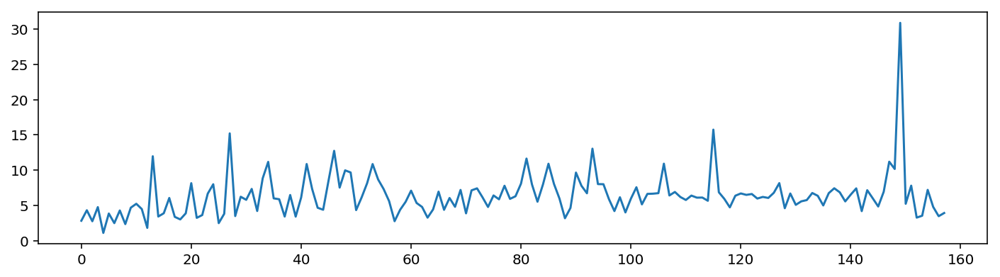

	 	 Test subset results
Test mean absolute percentage error per hour: 3.469404
Test mean absolute percentage error per day: 9.842287 
	 	 Validation Forecasting visualisation


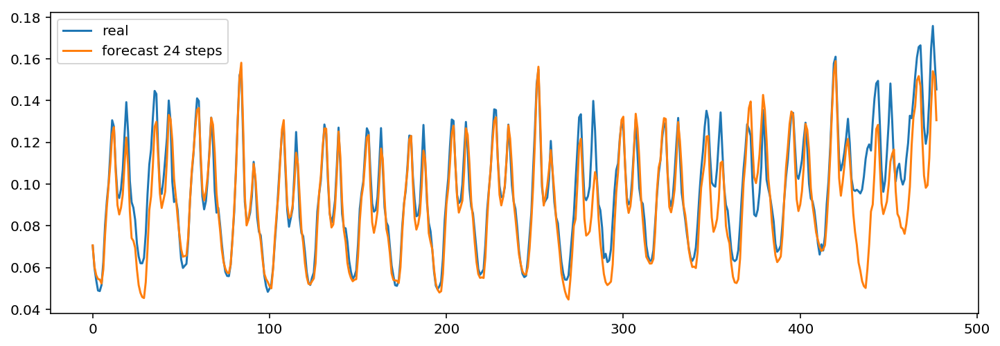

	 	 Forecasting a sample from Learning dataset


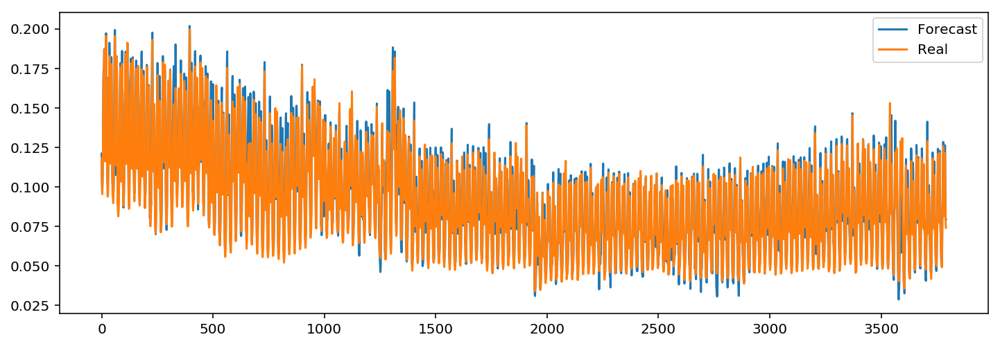

In [24]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 13
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.72113750201 
Daily Learning mean absolute percentage error of 158 days : 5.29919756817 
	 	 MAPError plot through Learning DataSet 


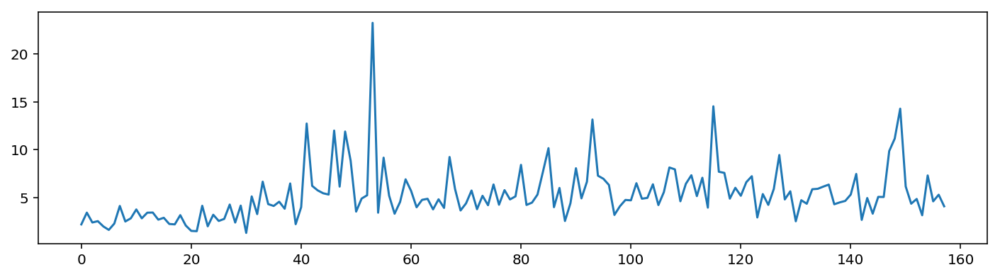

	 	 Test subset results
Test mean absolute percentage error per hour: 3.542149
Test mean absolute percentage error per day: 8.417989 
	 	 Validation Forecasting visualisation


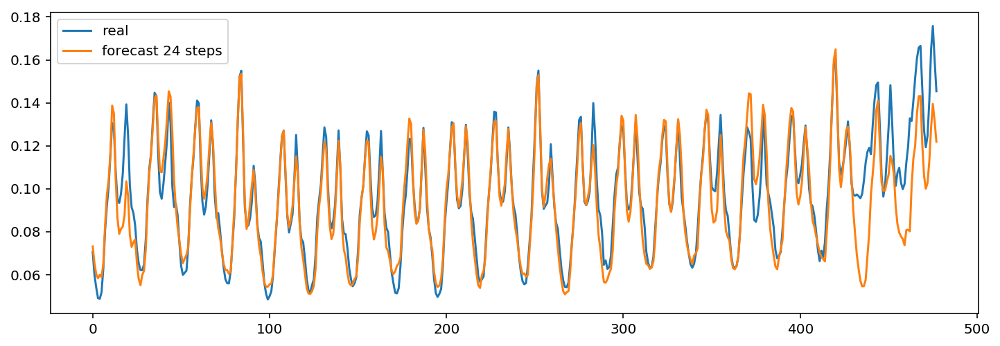

	 	 Forecasting a sample from Learning dataset


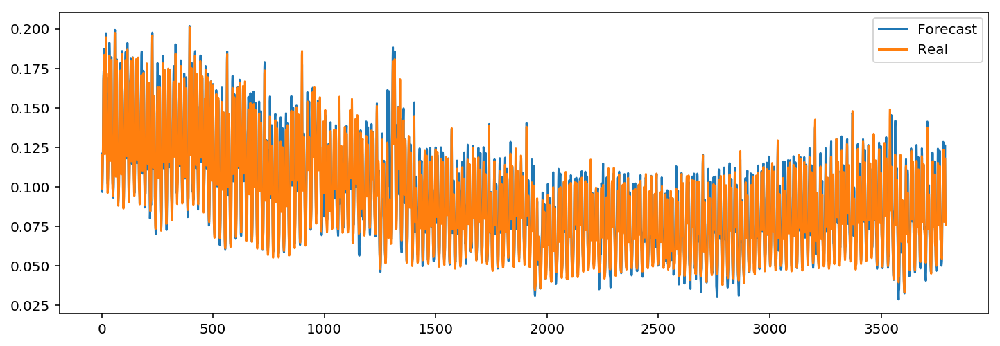

In [25]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()
MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 14
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.75805851313 
Daily Learning mean absolute percentage error of 158 days : 5.93489678676 
	 	 MAPError plot through Learning DataSet 


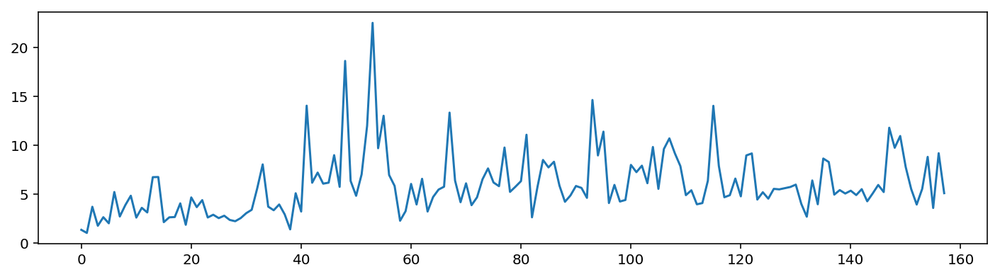

	 	 Test subset results
Test mean absolute percentage error per hour: 3.512935
Test mean absolute percentage error per day: 8.160378 
	 	 Validation Forecasting visualisation


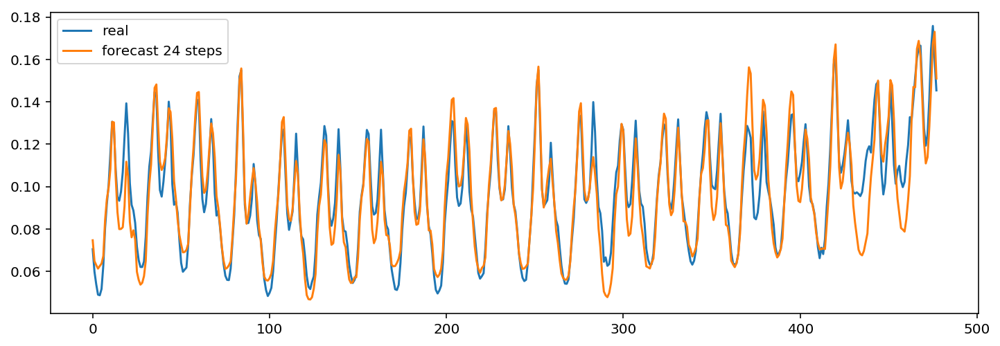

	 	 Forecasting a sample from Learning dataset


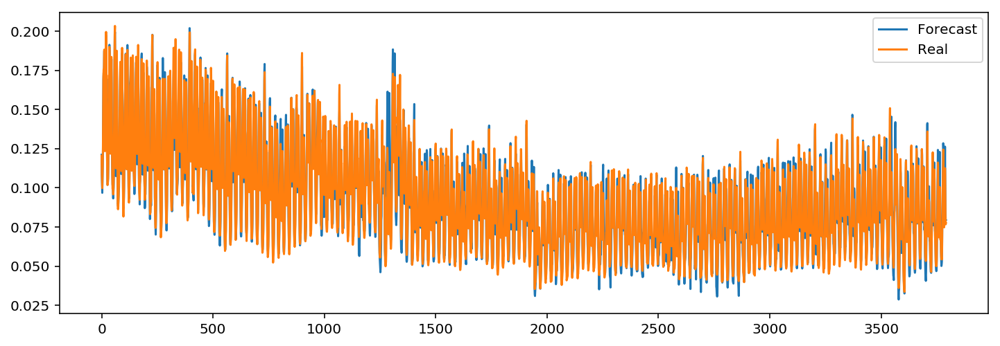

In [26]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 15
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.33220178398 
Daily Learning mean absolute percentage error of 158 days : 6.79734850005 
	 	 MAPError plot through Learning DataSet 


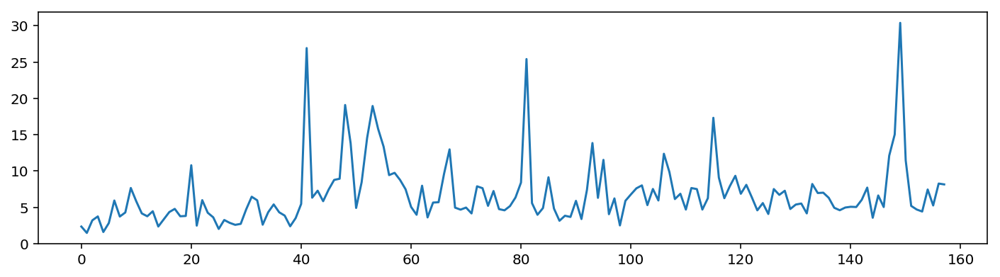

	 	 Test subset results
Test mean absolute percentage error per hour: 3.596055
Test mean absolute percentage error per day: 8.885821 
	 	 Validation Forecasting visualisation


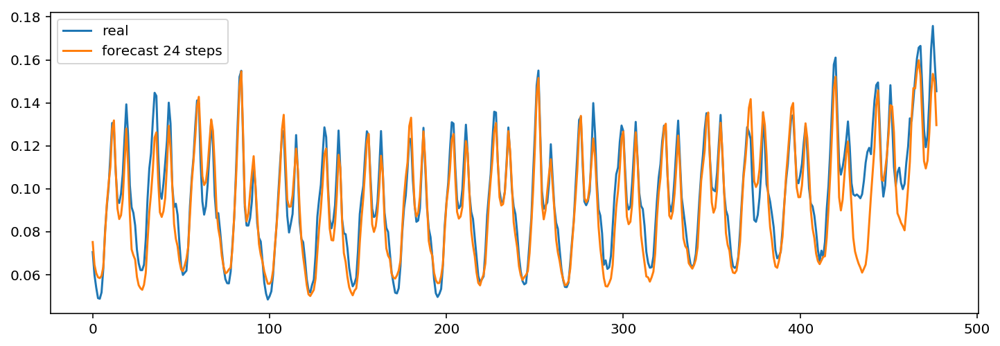

	 	 Forecasting a sample from Learning dataset


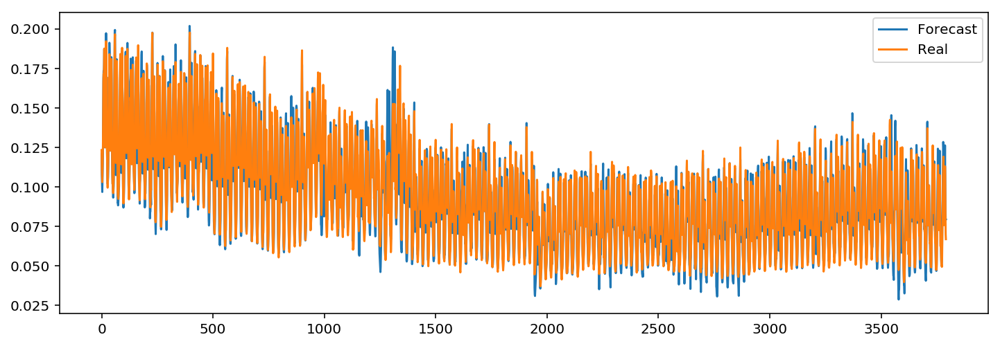

In [27]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 16
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.37349900875 
Daily Learning mean absolute percentage error of 158 days : 6.23601211777 
	 	 MAPError plot through Learning DataSet 


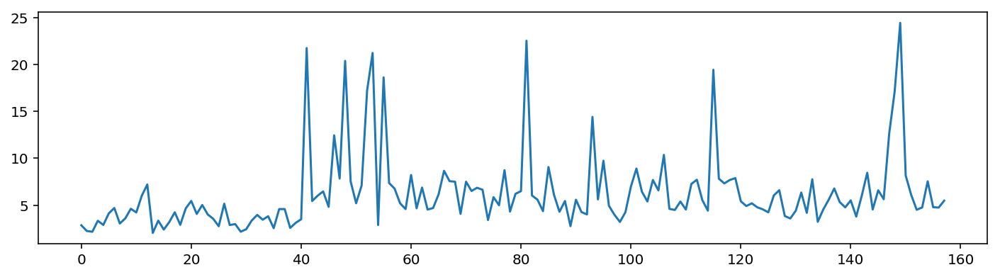

	 	 Test subset results
Test mean absolute percentage error per hour: 3.964907
Test mean absolute percentage error per day: 7.092292 
	 	 Validation Forecasting visualisation


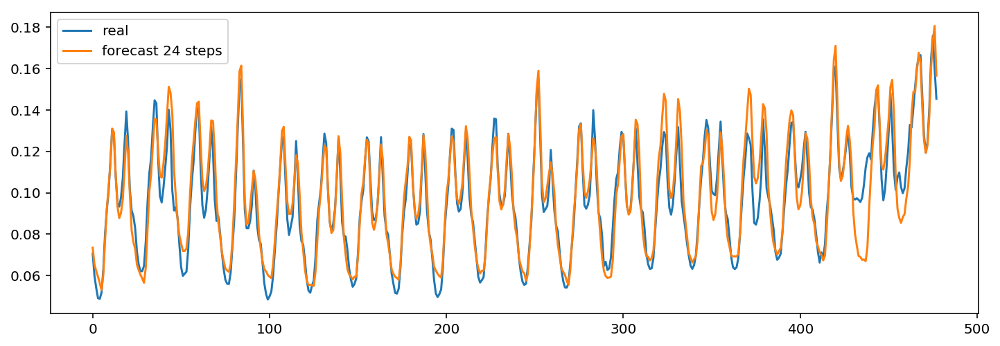

	 	 Forecasting a sample from Learning dataset


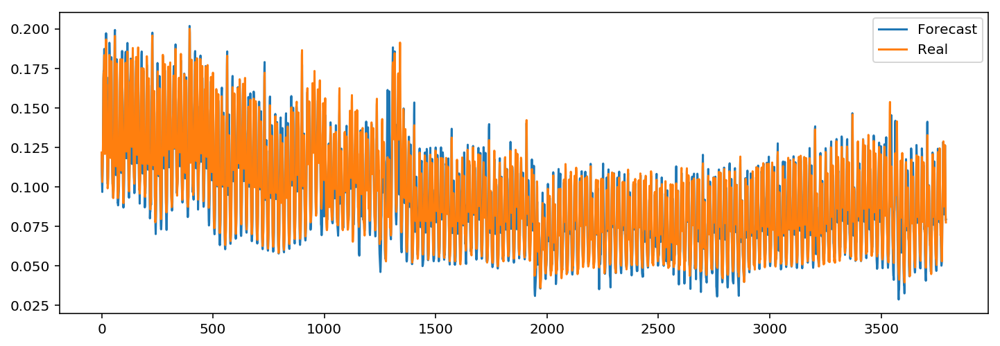

In [28]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = False
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [29]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2586.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.406693,9.333912
1,1.0,20.0,10.0,0.001,2640.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.988919,6.716752
2,2.0,20.0,10.0,0.001,2715.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.015656,7.068640
3,3.0,20.0,10.0,0.001,2871.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.913266,8.665655
4,4.0,20.0,10.0,0.001,1435.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.124283,6.826152
5,5.0,60.0,30.0,0.001,596.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.519961,7.324167
6,6.0,50.0,10.0,0.001,582.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.572646,7.126138
7,7.0,80.0,50.0,0.001,587.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.885845,7.510287
8,8.0,90.0,30.0,0.002,881.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,6.722212,7.715700
9,9.0,90.0,30.0,0.002,866.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,7.871737,7.132482


In [18]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2922.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.458268,9.076292
1,1.0,20.0,10.0,0.001,2428.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.466149,6.108062
2,2.0,20.0,10.0,0.001,2408.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.308474,6.620901
3,3.0,20.0,10.0,0.001,2989.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,7.388795,7.907170
4,4.0,20.0,10.0,0.001,1880.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.536155,6.935015
5,5.0,60.0,30.0,0.001,760.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.667644,6.665168
6,6.0,50.0,10.0,0.001,615.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.553245,8.632032
7,7.0,80.0,50.0,0.001,517.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.974749,8.108571
8,8.0,90.0,30.0,0.002,357.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,6.976730,6.573978


In [30]:
Epoch= 1000

	 	 test num : 17
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 6.5896579781 
Daily Learning mean absolute percentage error of 158 days : 9.90991626359 
	 	 MAPError plot through Learning DataSet 


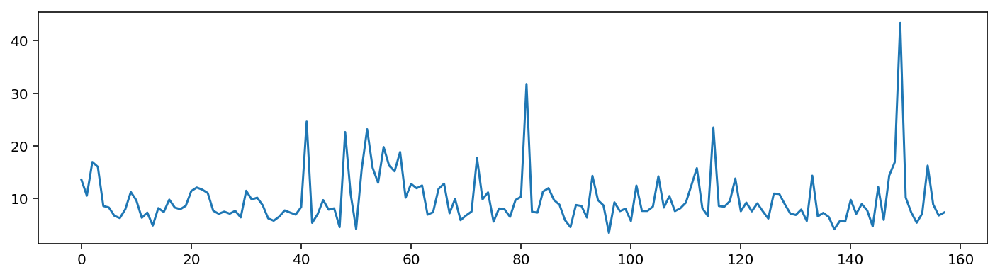

	 	 Test subset results
Test mean absolute percentage error per hour: 5.607048
Test mean absolute percentage error per day: 8.019112 
	 	 Validation Forecasting visualisation


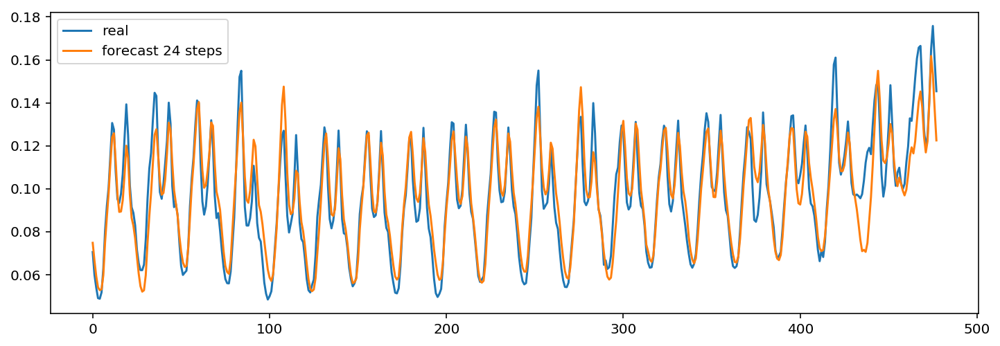

	 	 Forecasting a sample from Learning dataset


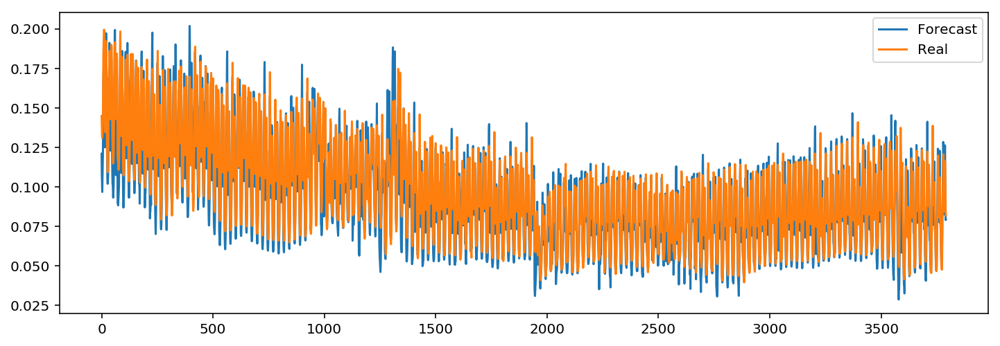

In [31]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 18
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 5.35472233622 
Daily Learning mean absolute percentage error of 158 days : 10.6511256906 
	 	 MAPError plot through Learning DataSet 


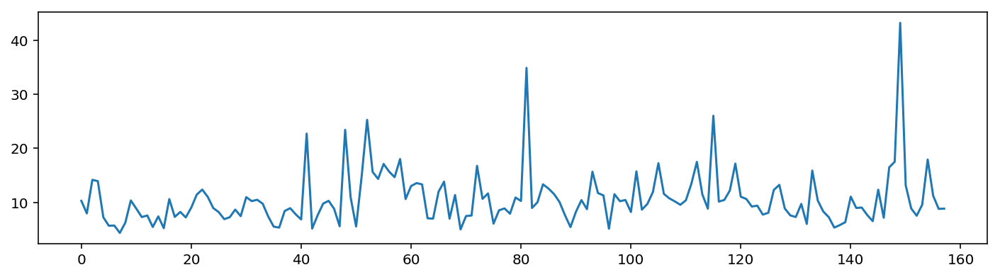

	 	 Test subset results
Test mean absolute percentage error per hour: 4.806164
Test mean absolute percentage error per day: 8.666039 
	 	 Validation Forecasting visualisation


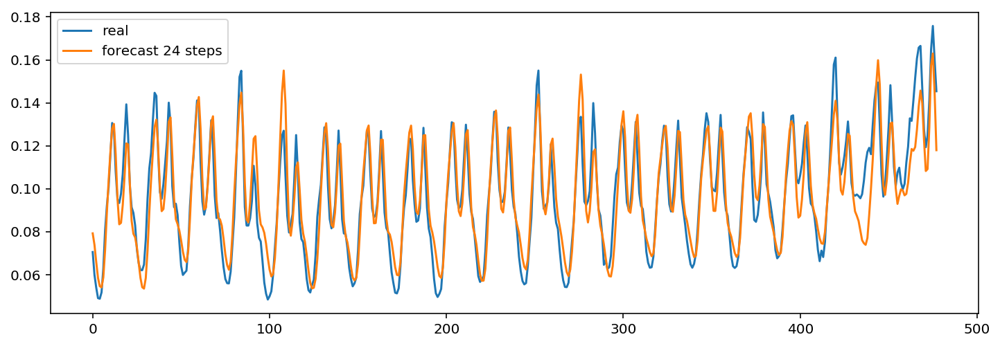

	 	 Forecasting a sample from Learning dataset


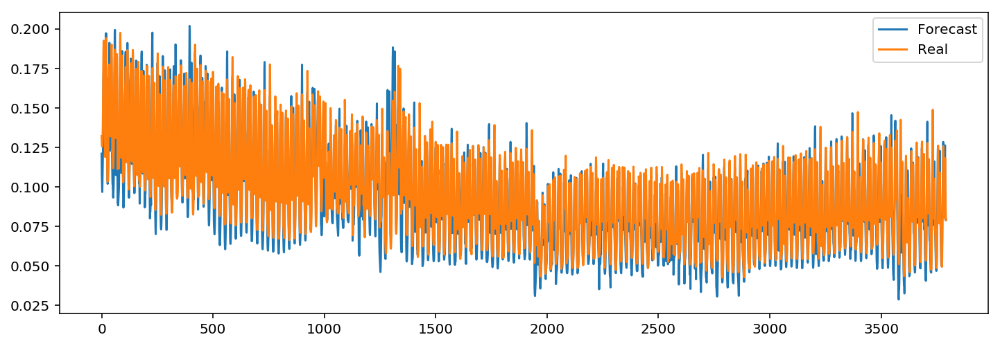

In [32]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 2
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 19
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 5.13465483927 
Daily Learning mean absolute percentage error of 158 days : 11.430135573 
	 	 MAPError plot through Learning DataSet 


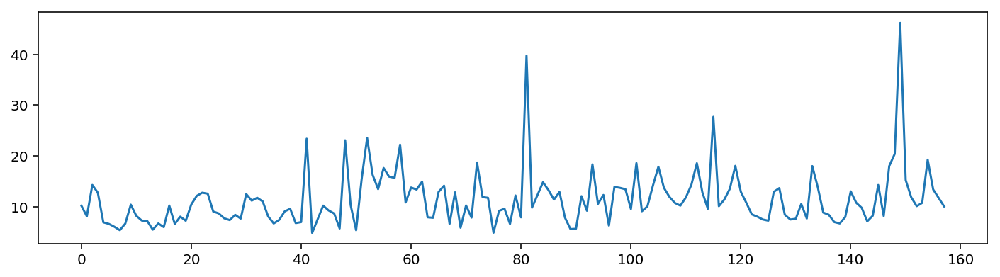

	 	 Test subset results
Test mean absolute percentage error per hour: 4.584643
Test mean absolute percentage error per day: 8.876909 
	 	 Validation Forecasting visualisation


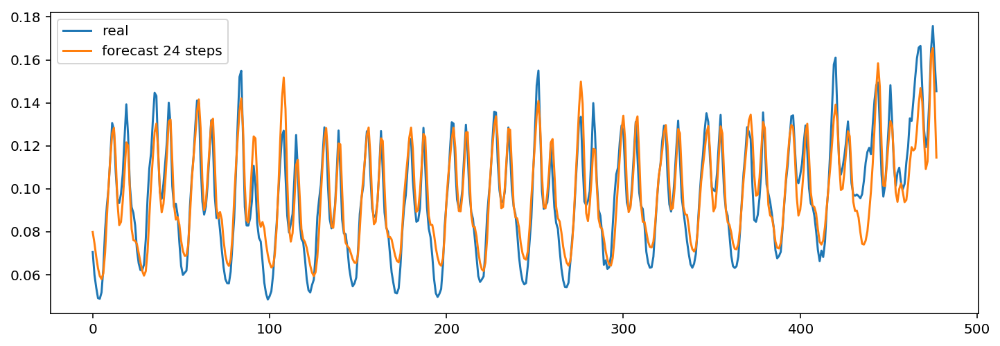

	 	 Forecasting a sample from Learning dataset


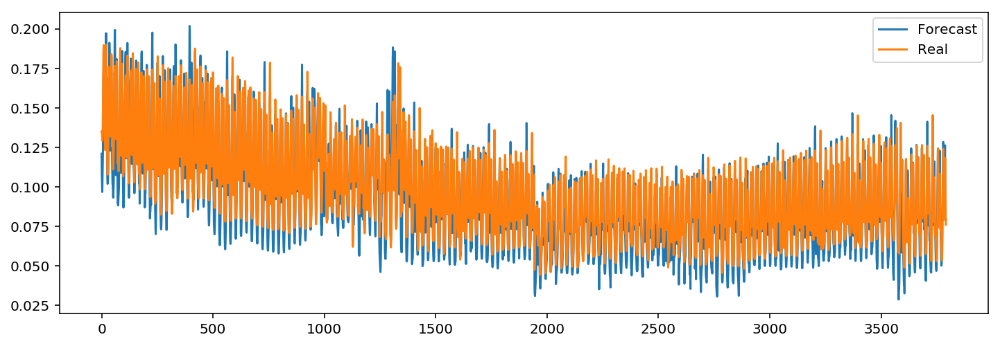

In [33]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 20
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 5.05623345001 
Daily Learning mean absolute percentage error of 158 days : 10.830492154 
	 	 MAPError plot through Learning DataSet 


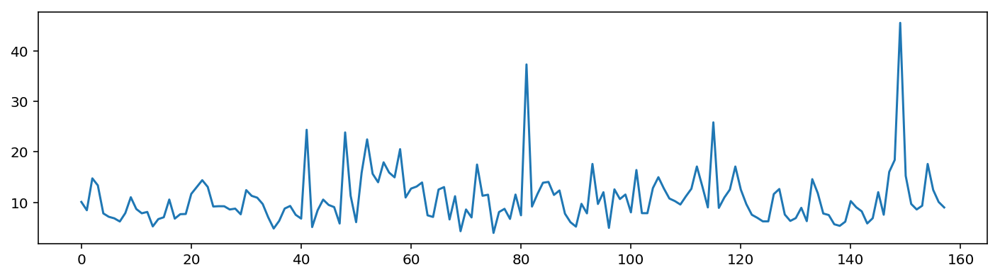

	 	 Test subset results
Test mean absolute percentage error per hour: 4.538006
Test mean absolute percentage error per day: 8.486889 
	 	 Validation Forecasting visualisation


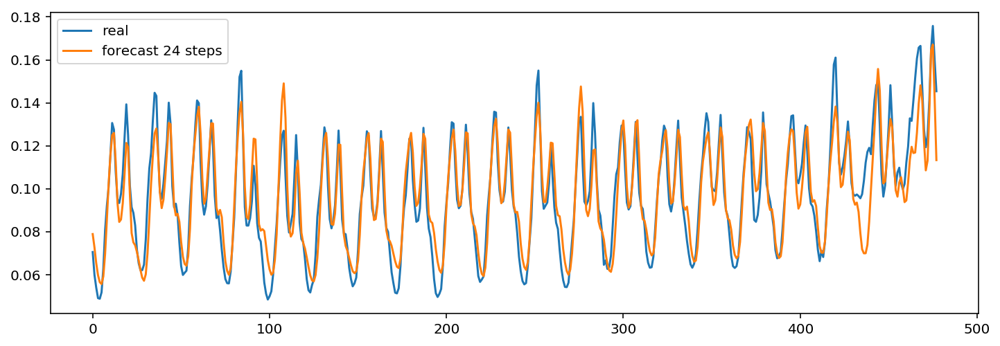

	 	 Forecasting a sample from Learning dataset


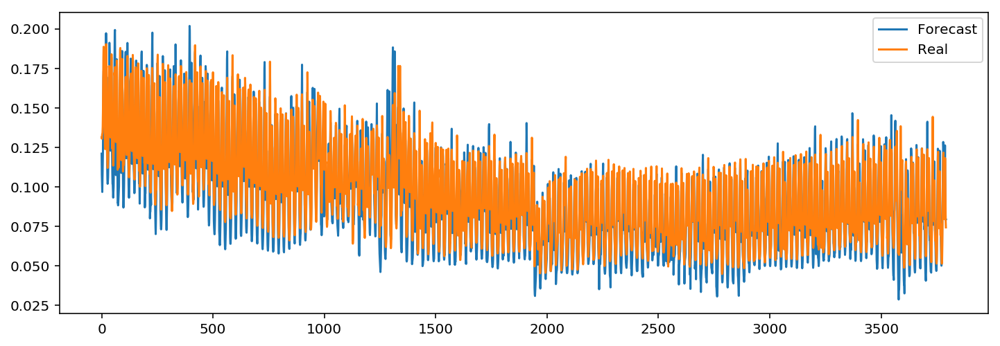

In [34]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 4
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 21
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.87861108146 
Daily Learning mean absolute percentage error of 158 days : 10.0873688972 
	 	 MAPError plot through Learning DataSet 


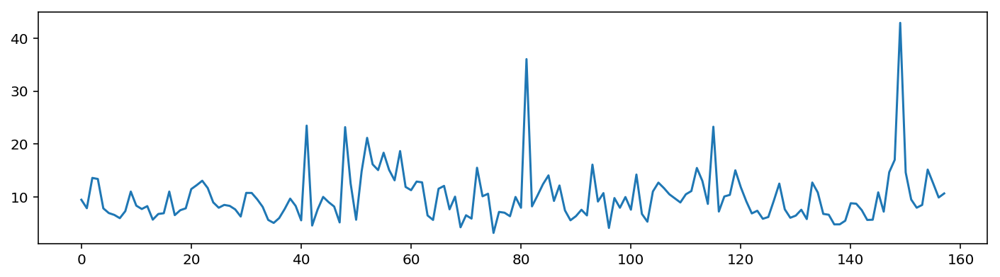

	 	 Test subset results
Test mean absolute percentage error per hour: 4.628405
Test mean absolute percentage error per day: 8.987548 
	 	 Validation Forecasting visualisation


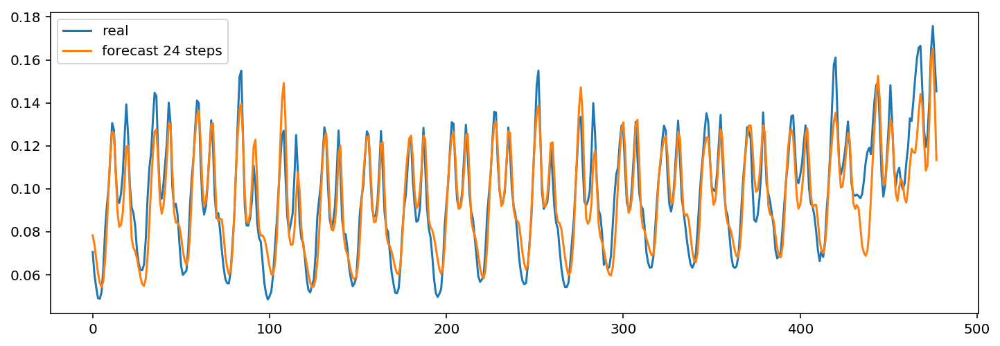

	 	 Forecasting a sample from Learning dataset


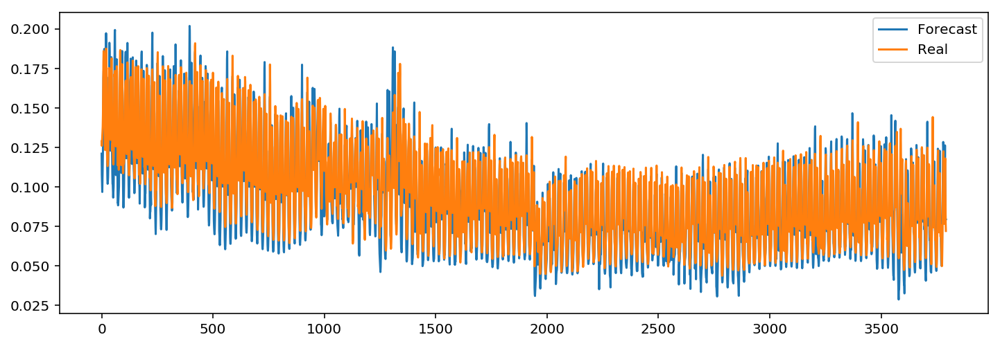

In [35]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 5
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 22
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.88351596254 
Daily Learning mean absolute percentage error of 158 days : 10.8188055935 
	 	 MAPError plot through Learning DataSet 


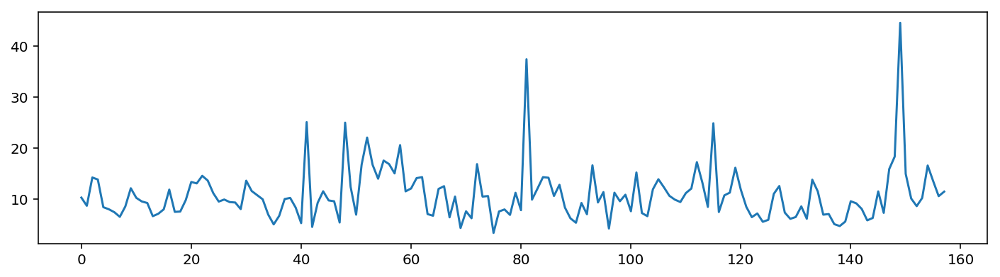

	 	 Test subset results
Test mean absolute percentage error per hour: 4.589686
Test mean absolute percentage error per day: 9.253693 
	 	 Validation Forecasting visualisation


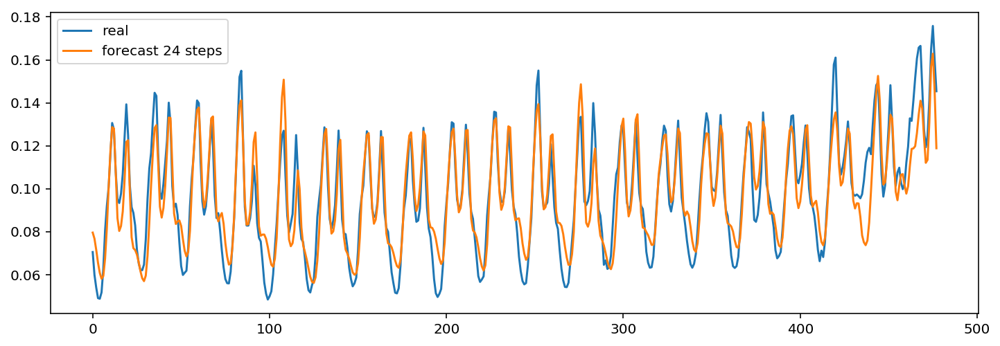

	 	 Forecasting a sample from Learning dataset


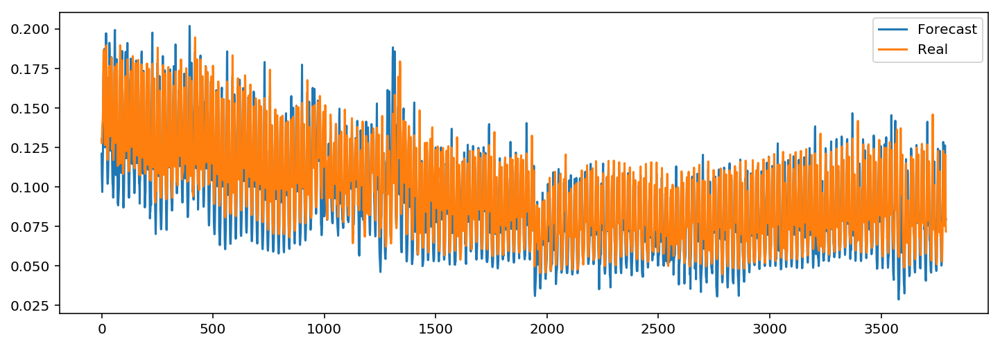

In [36]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 23
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.80115056769 
Daily Learning mean absolute percentage error of 158 days : 10.6817391039 
	 	 MAPError plot through Learning DataSet 


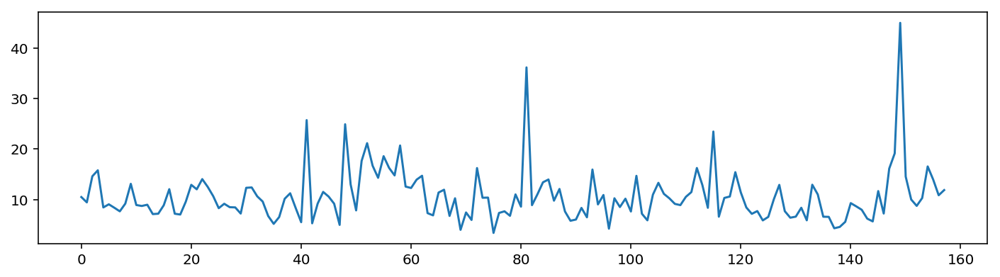

	 	 Test subset results
Test mean absolute percentage error per hour: 4.509753
Test mean absolute percentage error per day: 9.636352 
	 	 Validation Forecasting visualisation


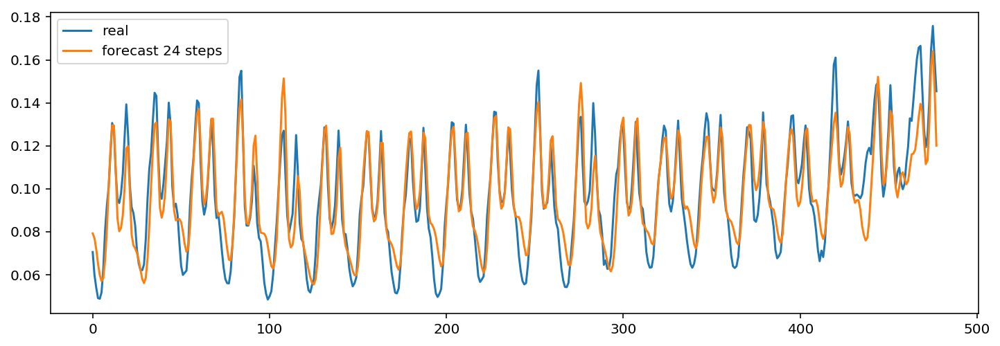

	 	 Forecasting a sample from Learning dataset


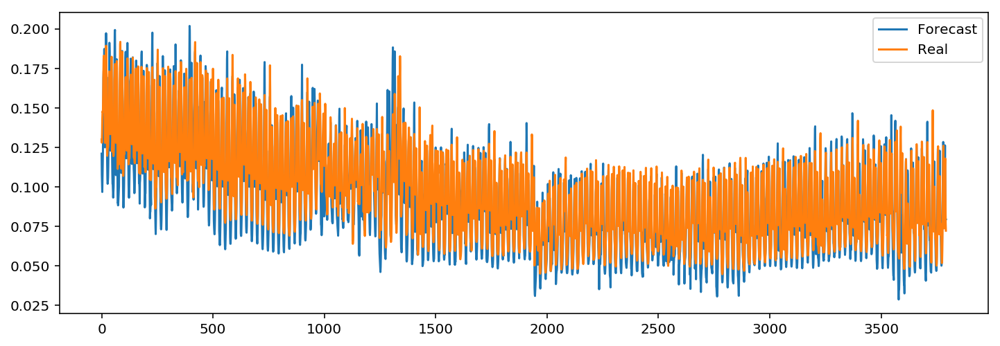

In [37]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 7
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 24
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.72033877571 
Daily Learning mean absolute percentage error of 158 days : 10.4346603487 
	 	 MAPError plot through Learning DataSet 


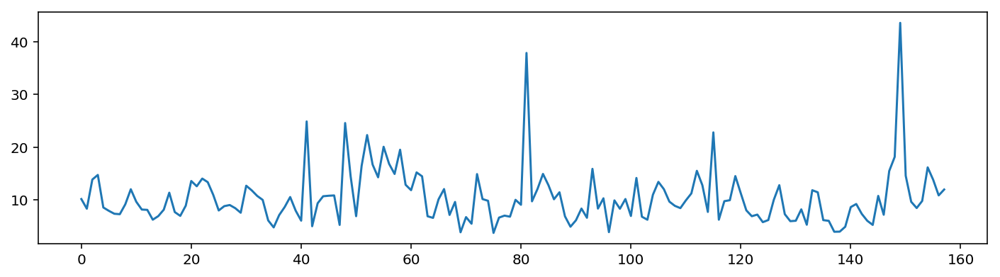

	 	 Test subset results
Test mean absolute percentage error per hour: 4.562658
Test mean absolute percentage error per day: 9.513979 
	 	 Validation Forecasting visualisation


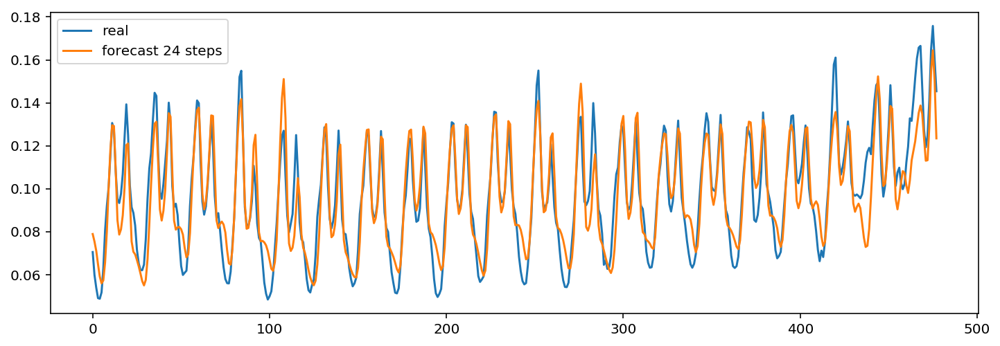

	 	 Forecasting a sample from Learning dataset


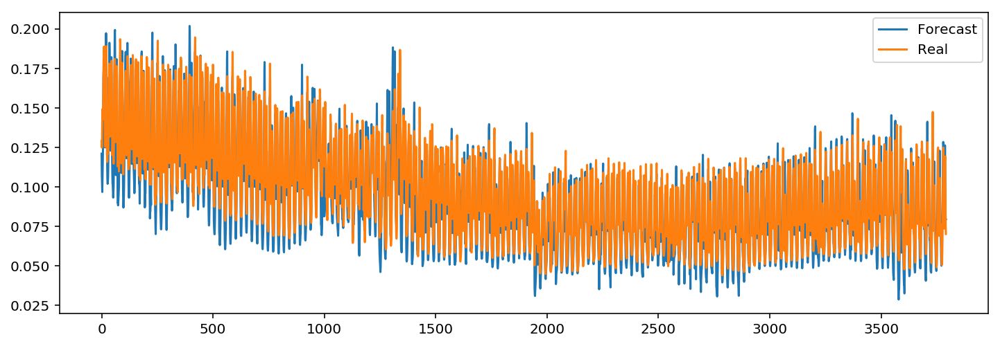

In [38]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 8
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 25
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.67994454915 
Daily Learning mean absolute percentage error of 158 days : 10.9831224665 
	 	 MAPError plot through Learning DataSet 


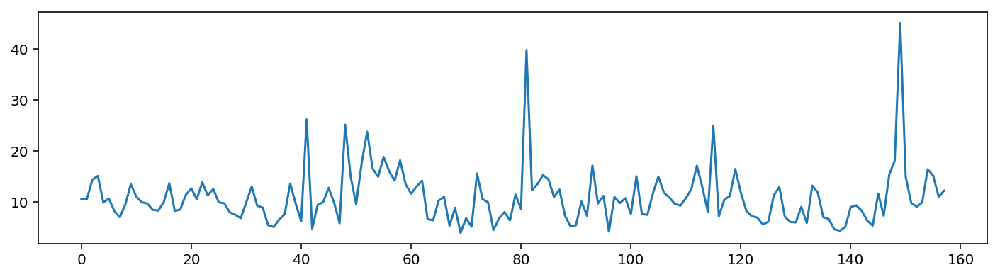

	 	 Test subset results
Test mean absolute percentage error per hour: 4.506601
Test mean absolute percentage error per day: 9.651436 
	 	 Validation Forecasting visualisation


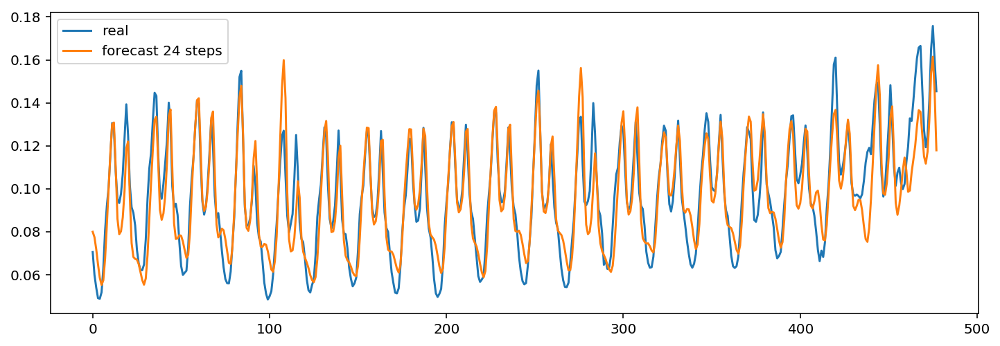

	 	 Forecasting a sample from Learning dataset


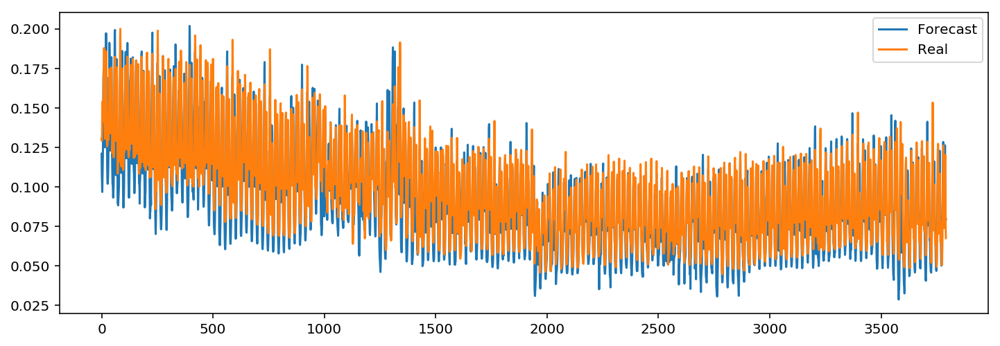

In [39]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 9
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 26
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.90540864614 
Daily Learning mean absolute percentage error of 158 days : 11.7758984656 
	 	 MAPError plot through Learning DataSet 


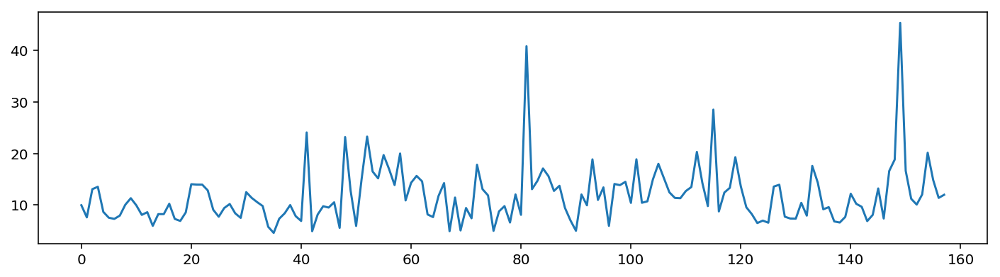

	 	 Test subset results
Test mean absolute percentage error per hour: 4.540723
Test mean absolute percentage error per day: 9.330845 
	 	 Validation Forecasting visualisation


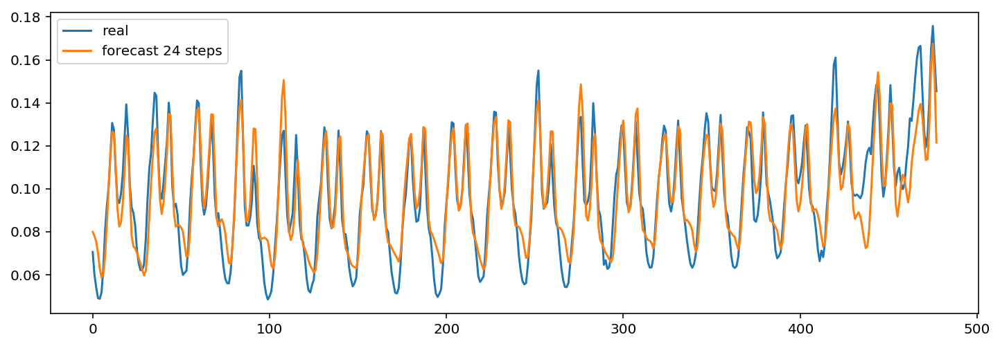

	 	 Forecasting a sample from Learning dataset


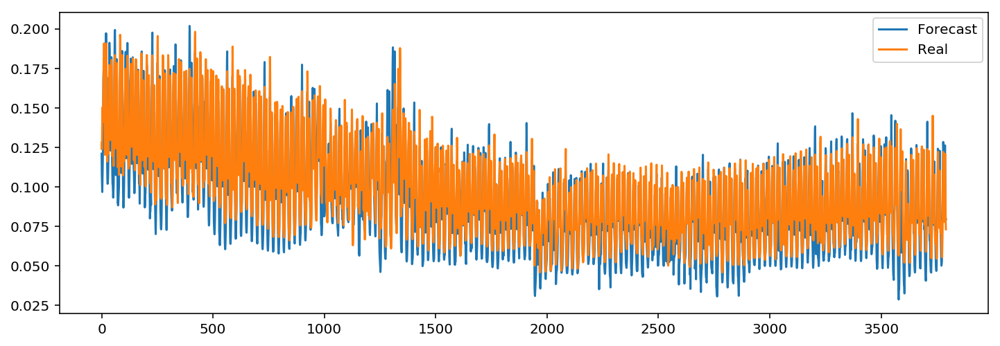

In [40]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 10
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 27
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.65081427365 
Daily Learning mean absolute percentage error of 158 days : 10.5430376032 
	 	 MAPError plot through Learning DataSet 


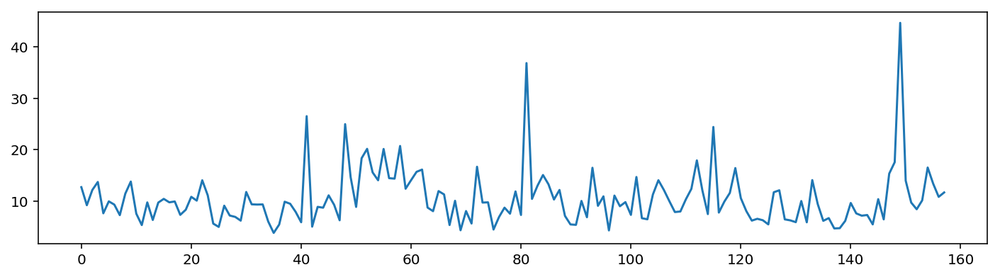

	 	 Test subset results
Test mean absolute percentage error per hour: 4.389490
Test mean absolute percentage error per day: 9.394345 
	 	 Validation Forecasting visualisation


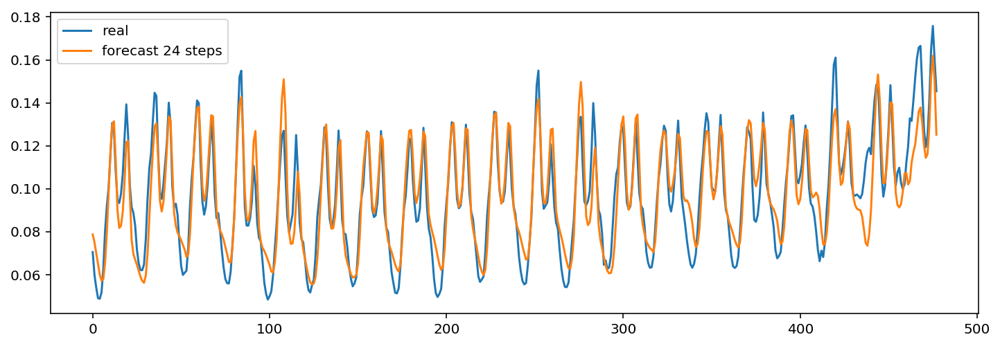

	 	 Forecasting a sample from Learning dataset


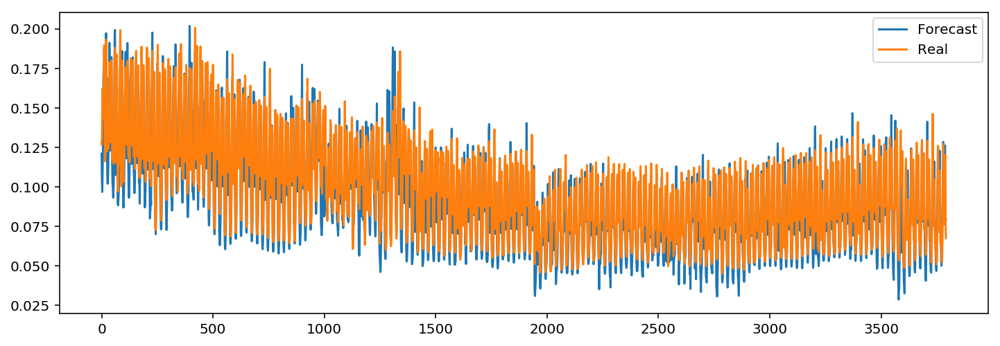

In [41]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 11
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 28
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.47987994608 
Daily Learning mean absolute percentage error of 158 days : 9.41319502456 
	 	 MAPError plot through Learning DataSet 


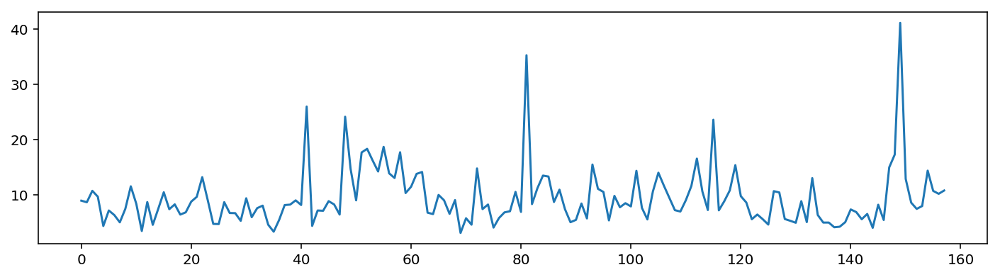

	 	 Test subset results
Test mean absolute percentage error per hour: 4.251915
Test mean absolute percentage error per day: 8.786897 
	 	 Validation Forecasting visualisation


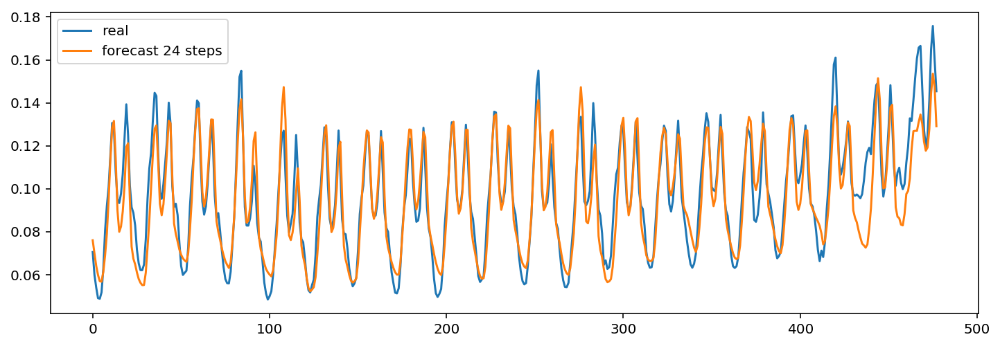

	 	 Forecasting a sample from Learning dataset


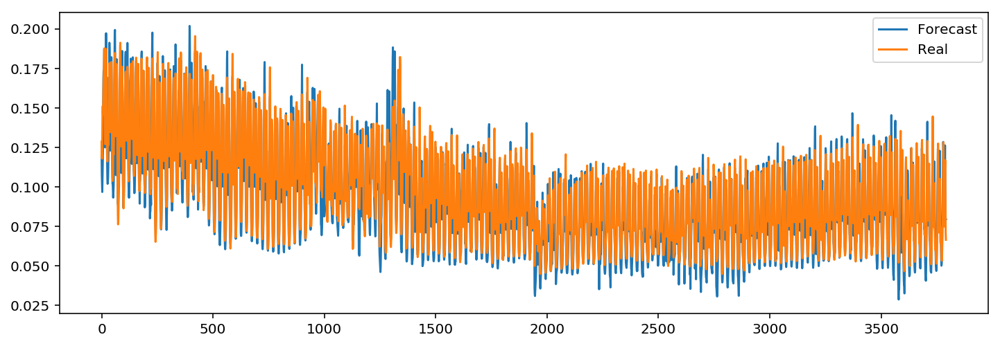

In [42]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [43]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2586.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.406693,9.333912
1,1.0,20.0,10.0,0.001,2640.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.988919,6.716752
2,2.0,20.0,10.0,0.001,2715.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.015656,7.068640
3,3.0,20.0,10.0,0.001,2871.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.913266,8.665655
4,4.0,20.0,10.0,0.001,1435.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.124283,6.826152
5,5.0,60.0,30.0,0.001,596.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,6.519961,7.324167
6,6.0,50.0,10.0,0.001,582.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.572646,7.126138
7,7.0,80.0,50.0,0.001,587.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,5.885845,7.510287
8,8.0,90.0,30.0,0.002,881.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,6.722212,7.715700
9,9.0,90.0,30.0,0.002,866.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,7.871737,7.132482


In [56]:
xmodel = ModelsList[1]
xmodel.optimizer.lr.get_value()

array(0.0010000000474974513, dtype=float32)

In [58]:
Epoch= 1000

	 	 test num : 29
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.31321617529 
Daily Learning mean absolute percentage error of 158 days : 9.10015400905 
	 	 MAPError plot through Learning DataSet 


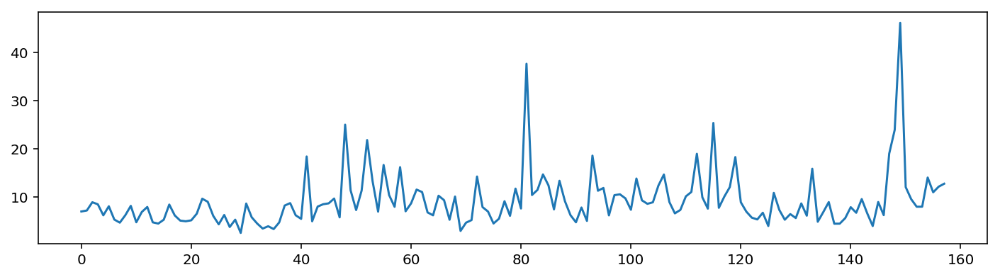

	 	 Test subset results
Test mean absolute percentage error per hour: 3.892220
Test mean absolute percentage error per day: 8.455196 
	 	 Validation Forecasting visualisation


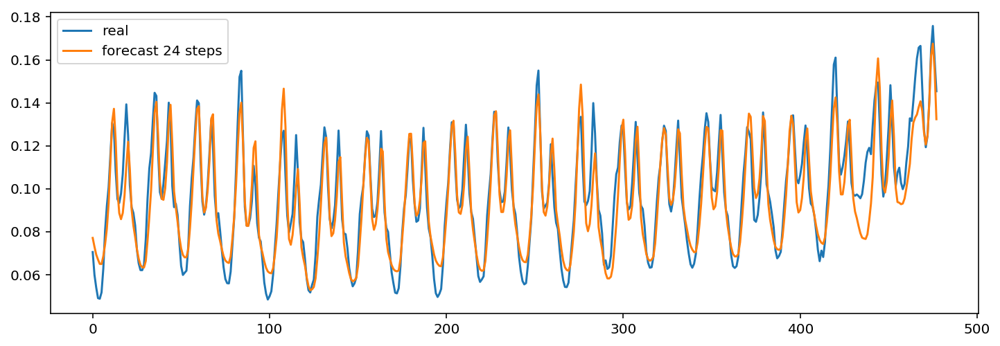

	 	 Forecasting a sample from Learning dataset


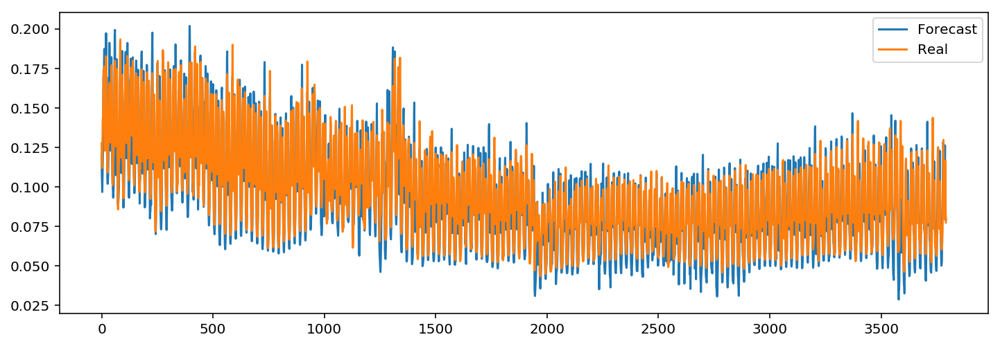

In [60]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 30
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.626238482 
Daily Learning mean absolute percentage error of 158 days : 9.99779810483 
	 	 MAPError plot through Learning DataSet 


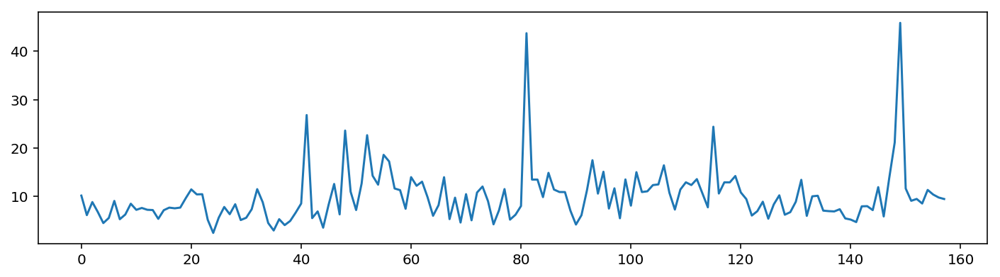

	 	 Test subset results
Test mean absolute percentage error per hour: 4.056397
Test mean absolute percentage error per day: 7.950303 
	 	 Validation Forecasting visualisation


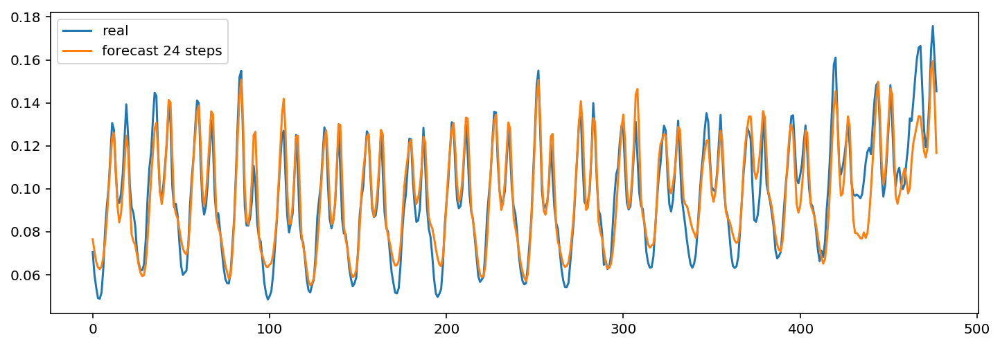

	 	 Forecasting a sample from Learning dataset


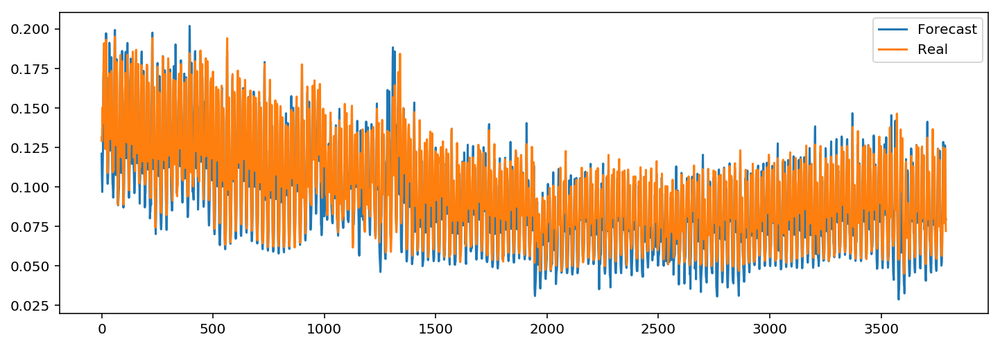

In [61]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 31
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.74082385594 
Daily Learning mean absolute percentage error of 158 days : 8.25262570608 
	 	 MAPError plot through Learning DataSet 


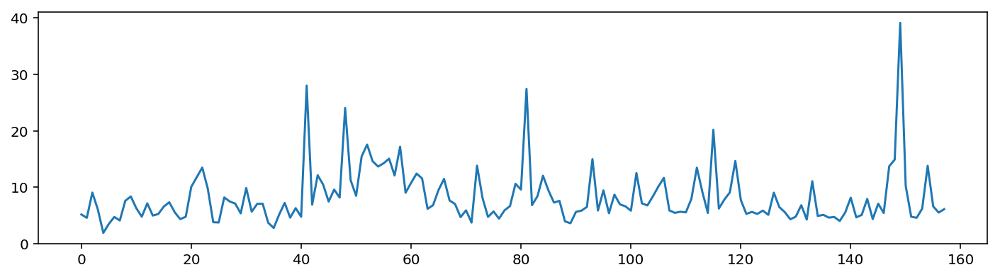

	 	 Test subset results
Test mean absolute percentage error per hour: 3.730427
Test mean absolute percentage error per day: 7.671776 
	 	 Validation Forecasting visualisation


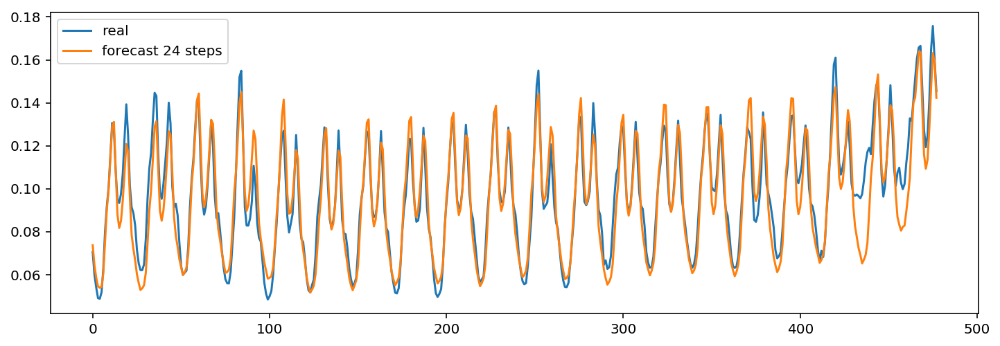

	 	 Forecasting a sample from Learning dataset


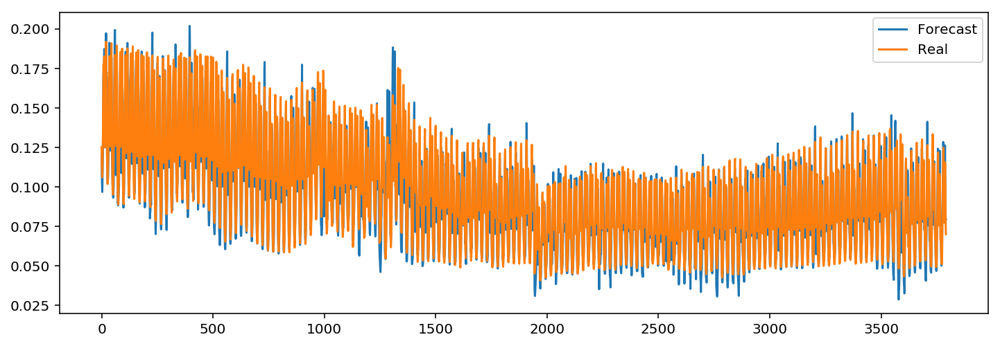

In [62]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 32
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 6.58922401073 
Daily Learning mean absolute percentage error of 158 days : 9.74443119538 
	 	 MAPError plot through Learning DataSet 


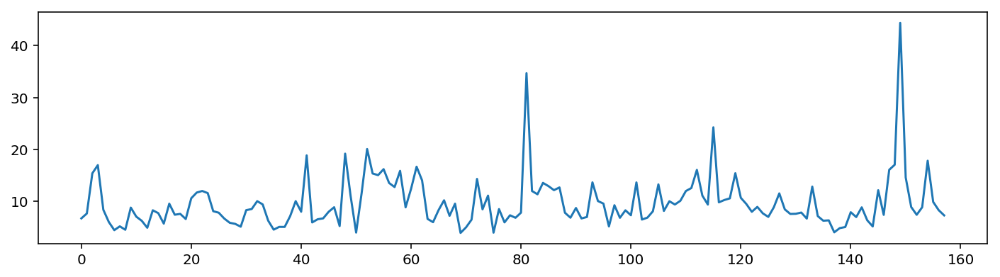

	 	 Test subset results
Test mean absolute percentage error per hour: 6.433905
Test mean absolute percentage error per day: 8.918622 
	 	 Validation Forecasting visualisation


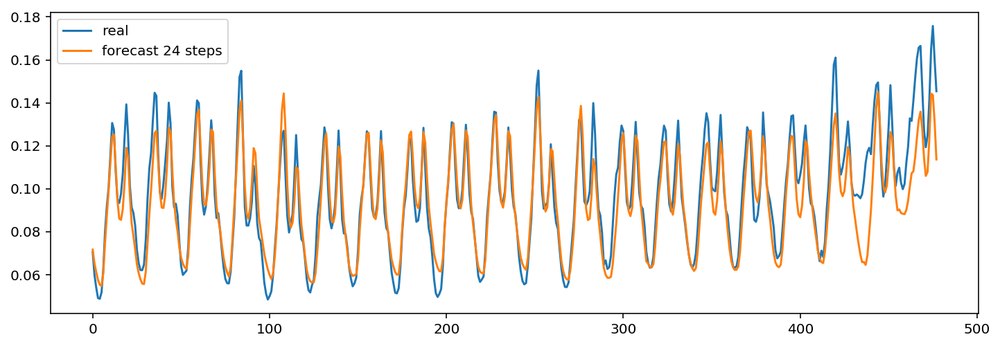

	 	 Forecasting a sample from Learning dataset


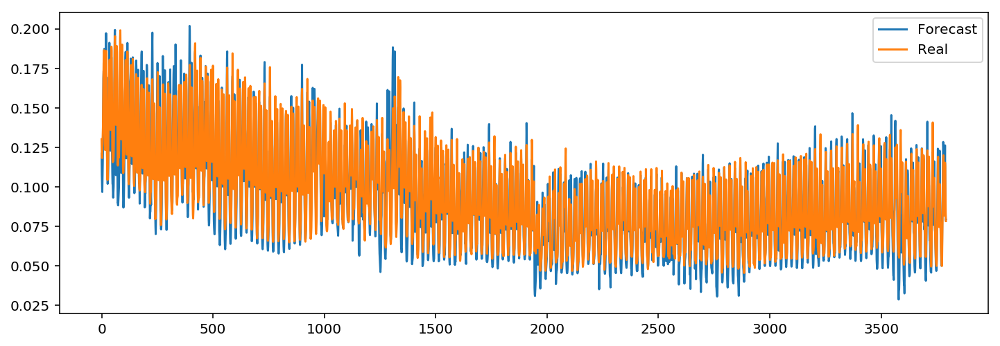

In [63]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 33
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.29805436365 
Daily Learning mean absolute percentage error of 158 days : 8.95276657388 
	 	 MAPError plot through Learning DataSet 


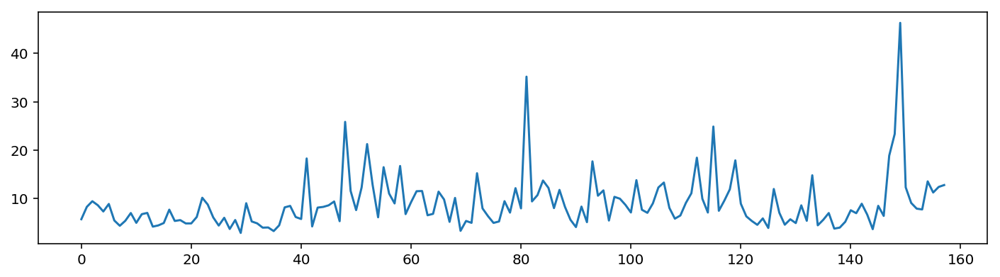

	 	 Test subset results
Test mean absolute percentage error per hour: 4.017655
Test mean absolute percentage error per day: 8.469554 
	 	 Validation Forecasting visualisation


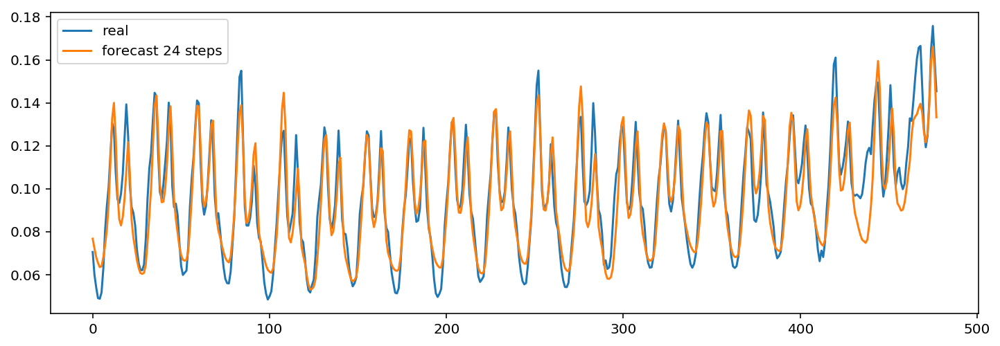

	 	 Forecasting a sample from Learning dataset


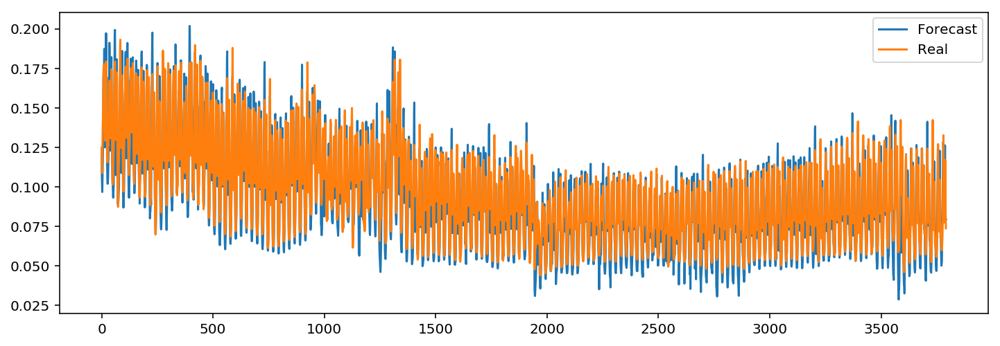

In [64]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 34
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.00071931974 
Daily Learning mean absolute percentage error of 158 days : 7.19867870325 
	 	 MAPError plot through Learning DataSet 


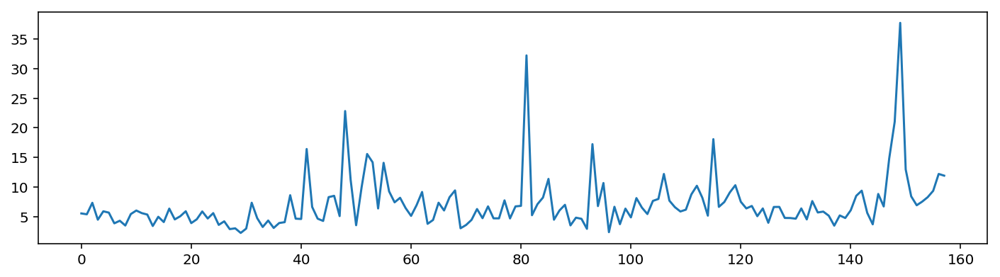

	 	 Test subset results
Test mean absolute percentage error per hour: 3.870720
Test mean absolute percentage error per day: 8.835016 
	 	 Validation Forecasting visualisation


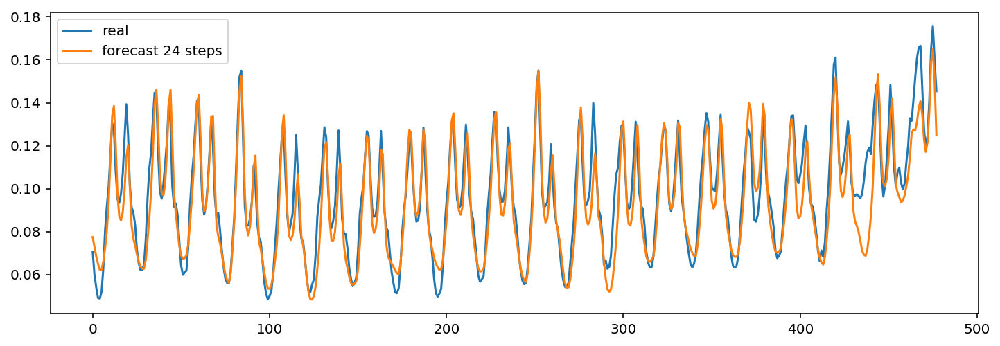

	 	 Forecasting a sample from Learning dataset


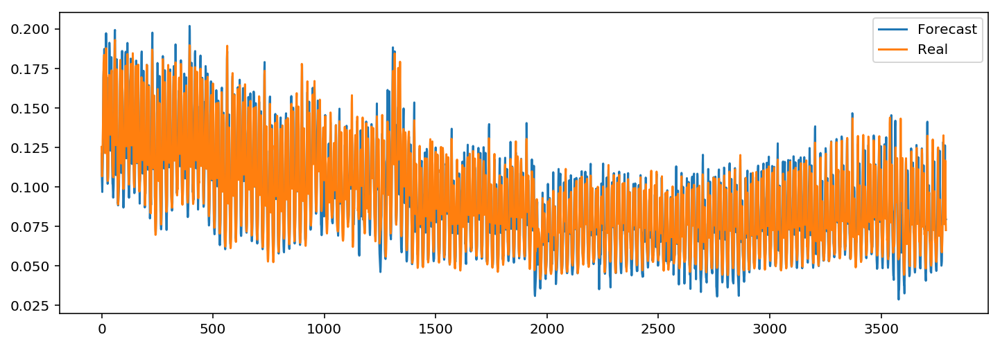

In [65]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 35
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.57606472477 
Daily Learning mean absolute percentage error of 158 days : 6.93209386551 
	 	 MAPError plot through Learning DataSet 


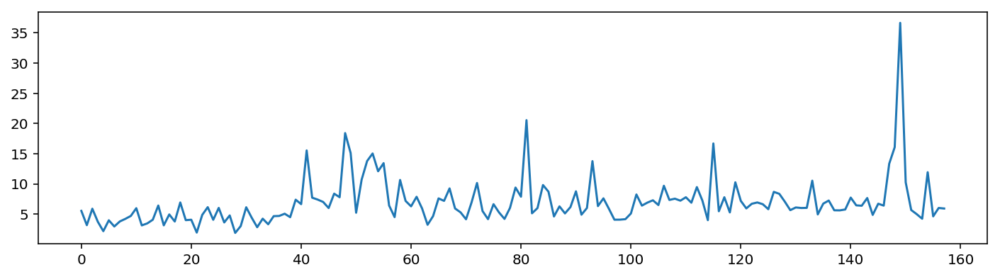

	 	 Test subset results
Test mean absolute percentage error per hour: 3.629878
Test mean absolute percentage error per day: 8.372116 
	 	 Validation Forecasting visualisation


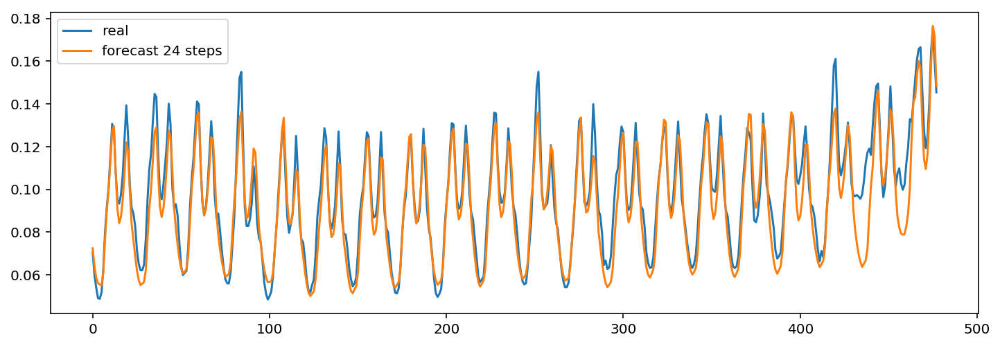

	 	 Forecasting a sample from Learning dataset


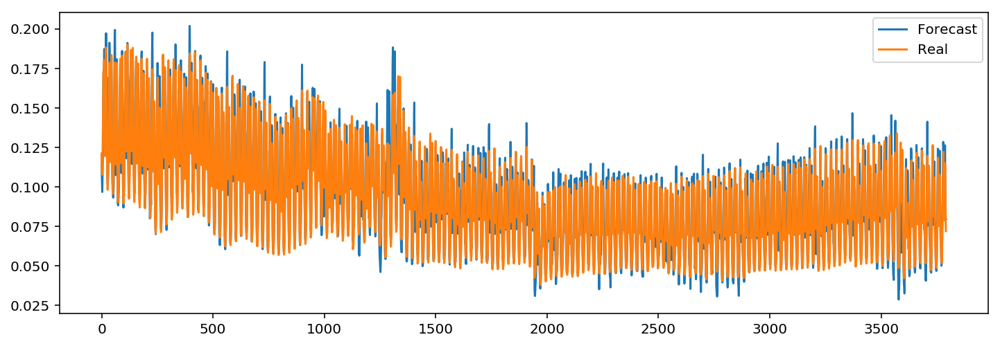

In [66]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 36
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.33298640428 
Daily Learning mean absolute percentage error of 158 days : 6.46672966209 
	 	 MAPError plot through Learning DataSet 


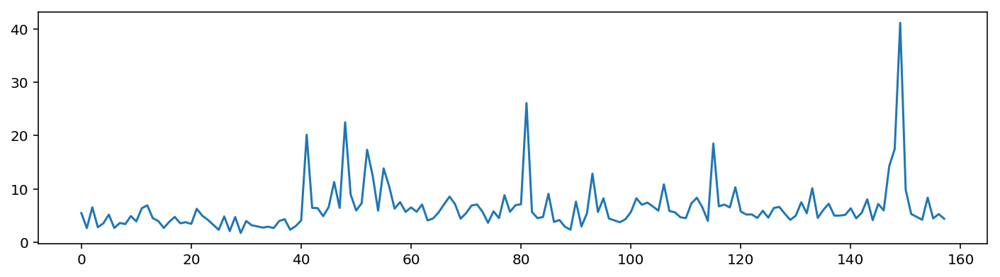

	 	 Test subset results
Test mean absolute percentage error per hour: 3.741022
Test mean absolute percentage error per day: 6.717045 
	 	 Validation Forecasting visualisation


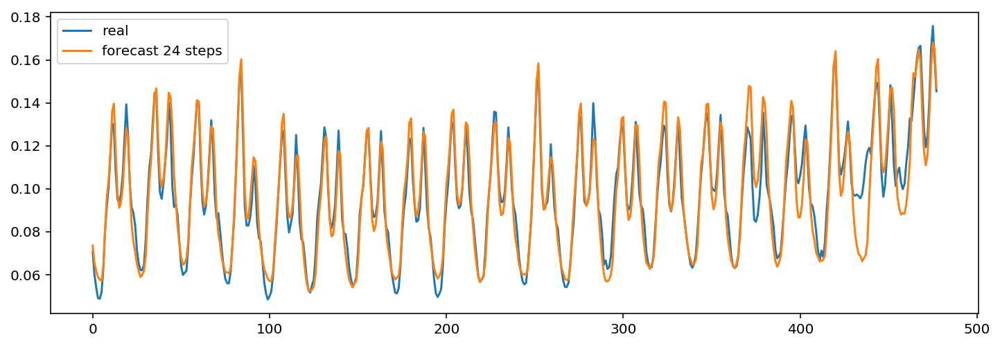

	 	 Forecasting a sample from Learning dataset


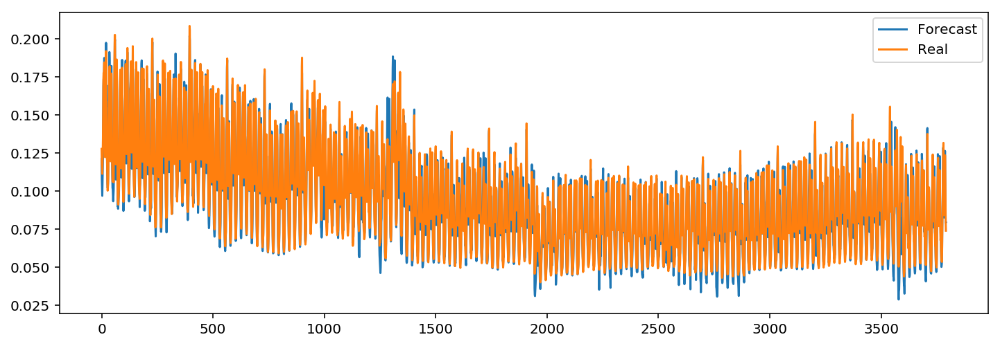

In [67]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 37
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 4.76944903162 
Daily Learning mean absolute percentage error of 158 days : 7.65639374679 
	 	 MAPError plot through Learning DataSet 


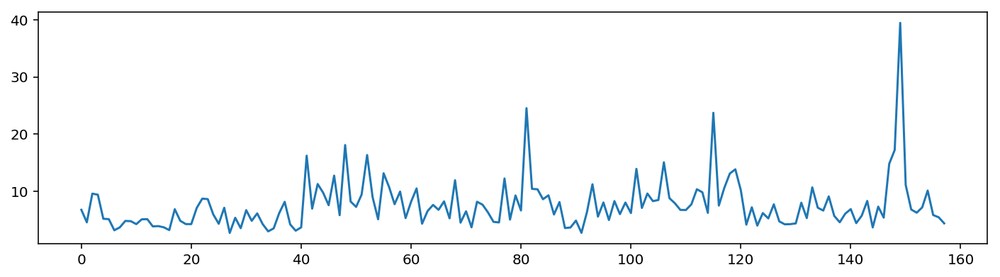

	 	 Test subset results
Test mean absolute percentage error per hour: 5.361959
Test mean absolute percentage error per day: 9.203388 
	 	 Validation Forecasting visualisation


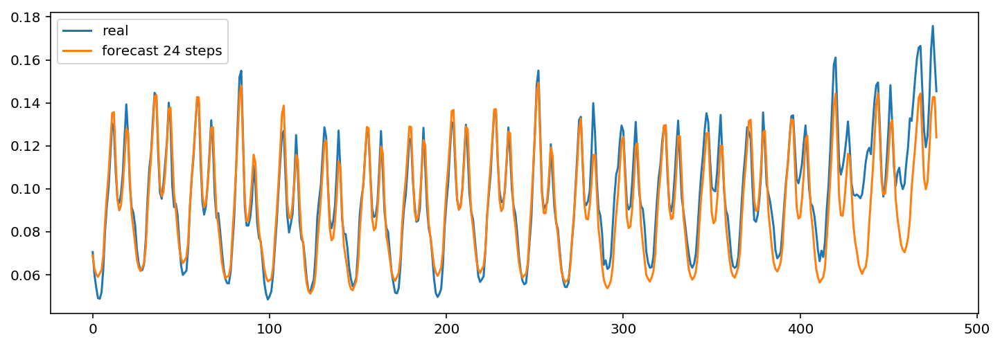

	 	 Forecasting a sample from Learning dataset


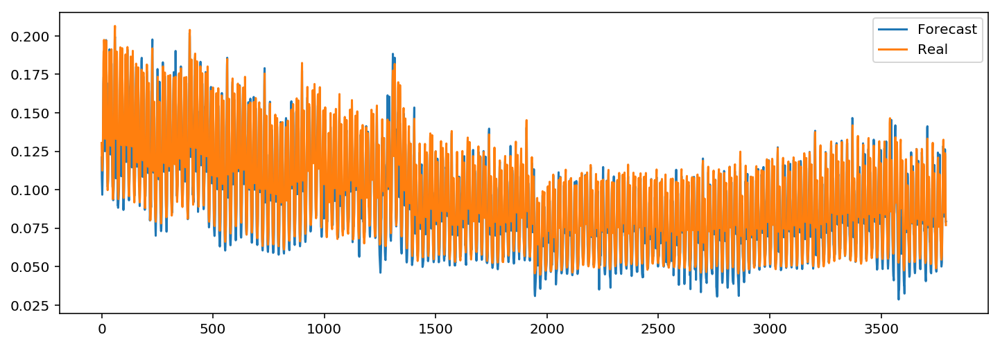

In [68]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [69]:
UsedInputs = np.array(UsedInputList[29:])

FinalError = np.array(MAPErrorList[29:])

summary = pd.DataFrame(np.concatenate((Models_IDs[29:],Models_parameters[29:],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,29.0,20.0,10.0,0.002,969.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,9.100154,8.455196
1,30.0,20.0,10.0,0.002,889.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,9.997798,7.950303
2,31.0,20.0,10.0,0.002,921.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,8.252626,7.671776
3,32.0,20.0,10.0,0.002,68.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,9.744431,8.918622
4,33.0,20.0,10.0,0.002,974.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,8.952767,8.469554
5,34.0,20.0,10.0,0.002,989.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,7.198679,8.835016
6,35.0,20.0,10.0,0.002,962.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,6.932094,8.372116
7,36.0,20.0,10.0,0.002,999.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,6.466730,6.717045
8,37.0,20.0,10.0,0.002,94.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,7.656394,9.203388


	 	 test num : 38
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.25735214819 
Daily Learning mean absolute percentage error of 158 days : 6.43582946062 
	 	 MAPError plot through Learning DataSet 


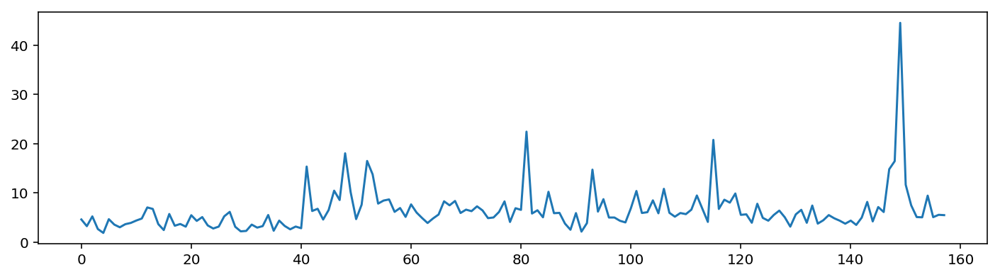

	 	 Test subset results
Test mean absolute percentage error per hour: 3.588803
Test mean absolute percentage error per day: 6.891235 
	 	 Validation Forecasting visualisation


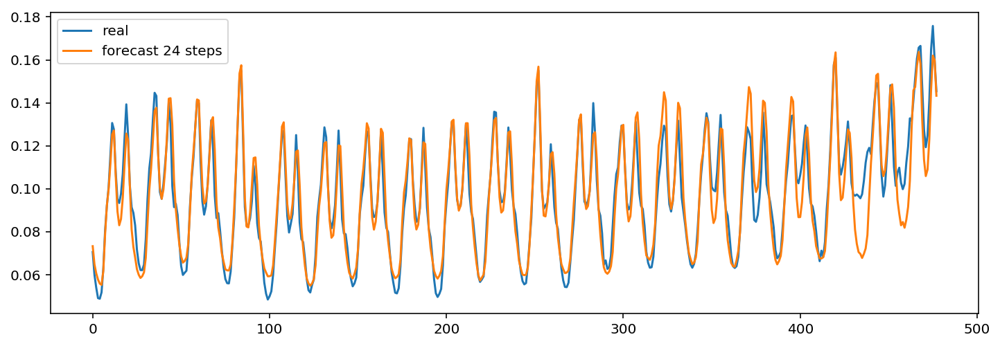

	 	 Forecasting a sample from Learning dataset


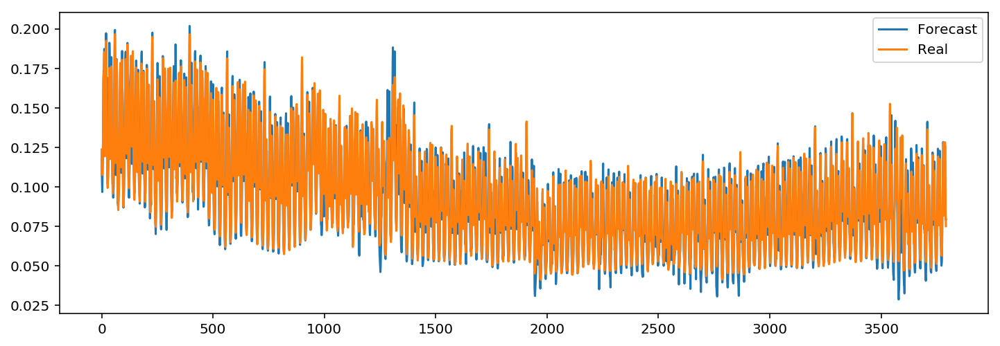

In [70]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 39
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.38321385527 
Daily Learning mean absolute percentage error of 158 days : 6.44821264321 
	 	 MAPError plot through Learning DataSet 


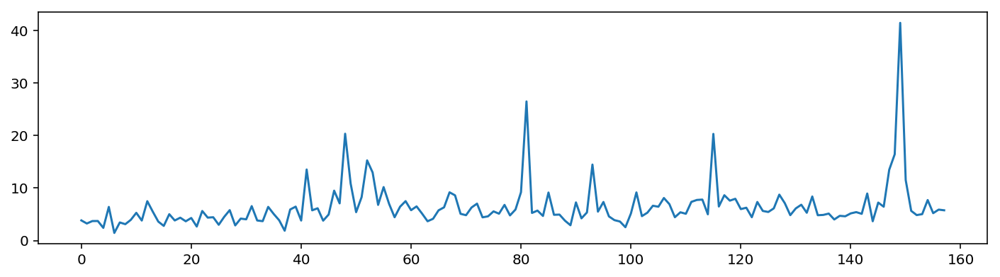

	 	 Test subset results
Test mean absolute percentage error per hour: 3.504927
Test mean absolute percentage error per day: 6.642237 
	 	 Validation Forecasting visualisation


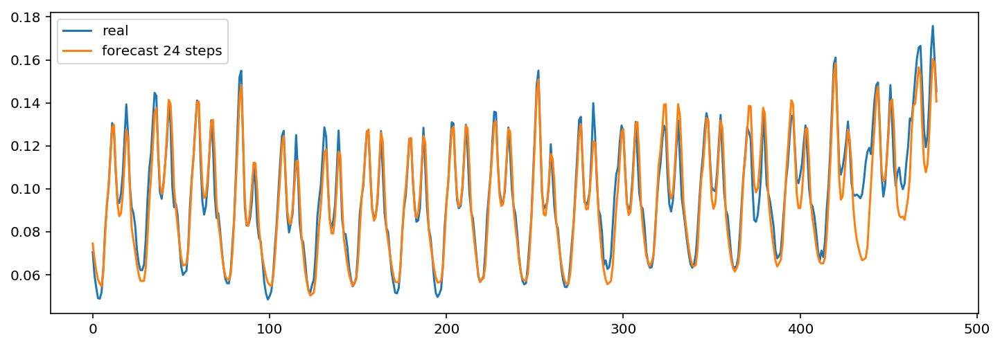

	 	 Forecasting a sample from Learning dataset


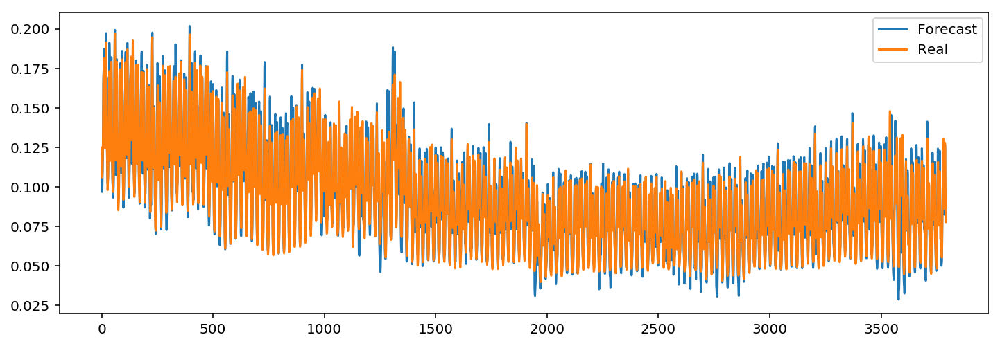

In [71]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [72]:
UsedInputs = np.array(UsedInputList[29:])

FinalError = np.array(MAPErrorList[29:])

summary = pd.DataFrame(np.concatenate((Models_IDs[29:],Models_parameters[29:],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,29.0,20.0,10.0,0.002,969.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,9.100154,8.455196
1,30.0,20.0,10.0,0.002,889.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,9.997798,7.950303
2,31.0,20.0,10.0,0.002,921.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,8.252626,7.671776
3,32.0,20.0,10.0,0.002,68.0,1.0,12.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,9.744431,8.918622
4,33.0,20.0,10.0,0.002,974.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,8.952767,8.469554
5,34.0,20.0,10.0,0.002,989.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,7.198679,8.835016
6,35.0,20.0,10.0,0.002,962.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,6.932094,8.372116
7,36.0,20.0,10.0,0.002,999.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,6.466730,6.717045
8,37.0,20.0,10.0,0.002,94.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,7.656394,9.203388
9,38.0,20.0,10.0,0.001,989.0,1.0,12.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,6.435829,6.891235


In [75]:
Epoch = 3500

	 	 test num : 41
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.82491964534 
Daily Learning mean absolute percentage error of 158 days : 7.23482491246 
	 	 MAPError plot through Learning DataSet 


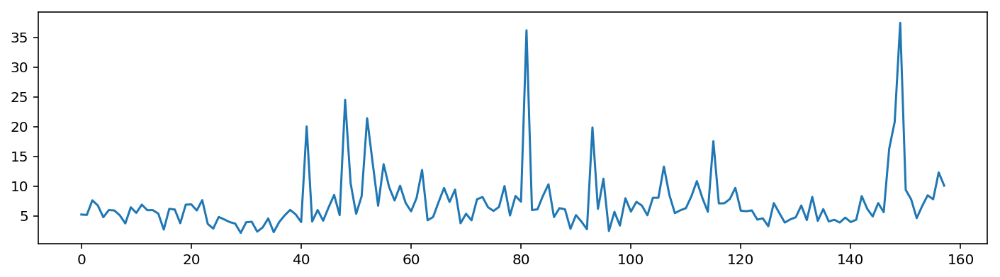

	 	 Test subset results
Test mean absolute percentage error per hour: 3.474050
Test mean absolute percentage error per day: 8.021080 
	 	 Validation Forecasting visualisation


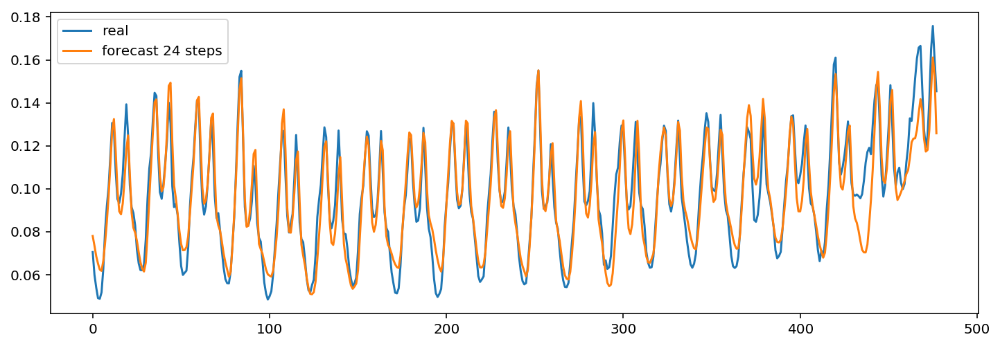

	 	 Forecasting a sample from Learning dataset


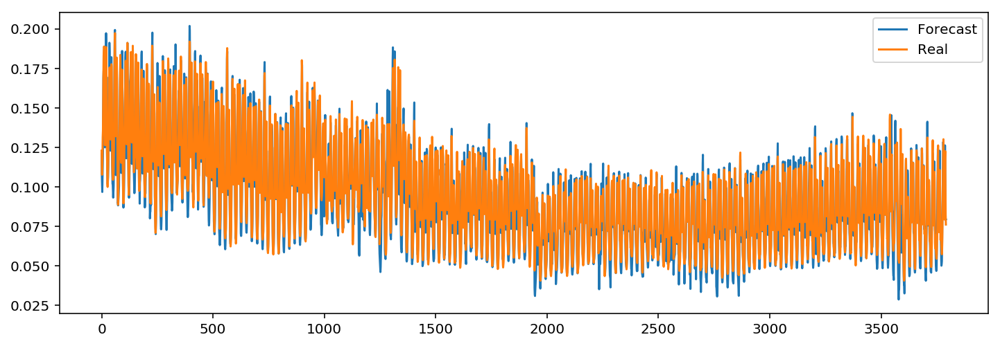

In [76]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[8] = MonthIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/summer/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 42
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.56595707353 
Daily Learning mean absolute percentage error of 158 days : 6.81084044221 
	 	 MAPError plot through Learning DataSet 


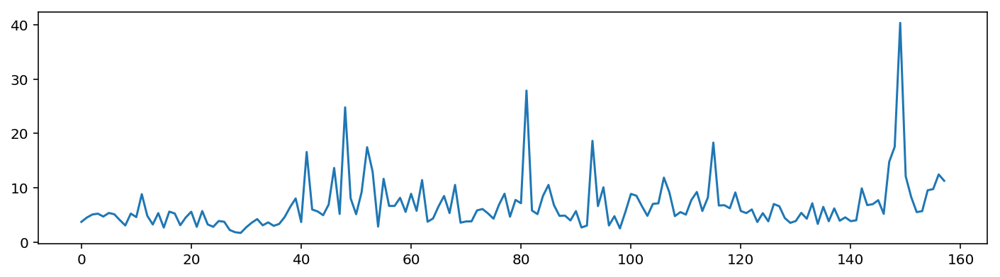

	 	 Test subset results
Test mean absolute percentage error per hour: 3.517000
Test mean absolute percentage error per day: 8.342333 
	 	 Validation Forecasting visualisation


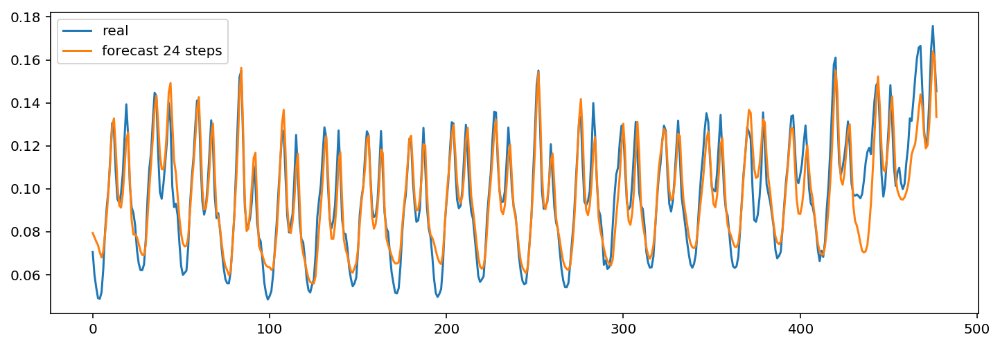

	 	 Forecasting a sample from Learning dataset


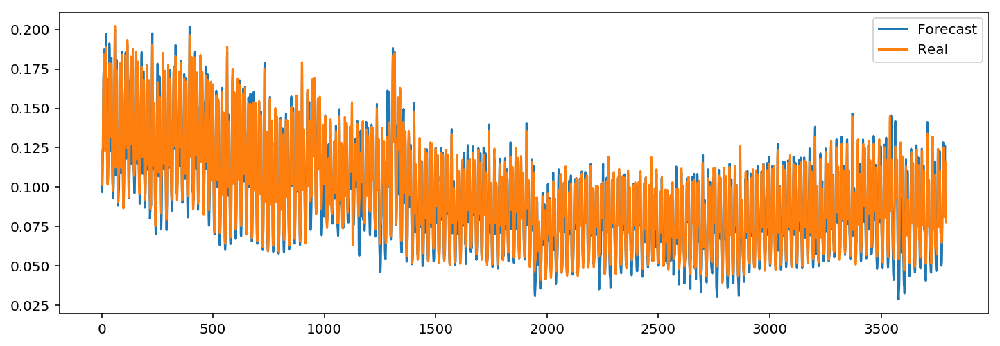

In [77]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[8] = MonthIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/summer/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 43
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.76100523677 
Daily Learning mean absolute percentage error of 158 days : 6.97577079112 
	 	 MAPError plot through Learning DataSet 


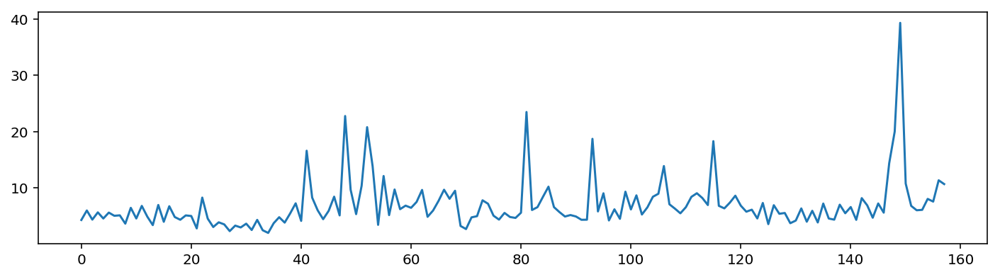

	 	 Test subset results
Test mean absolute percentage error per hour: 3.463079
Test mean absolute percentage error per day: 7.462663 
	 	 Validation Forecasting visualisation


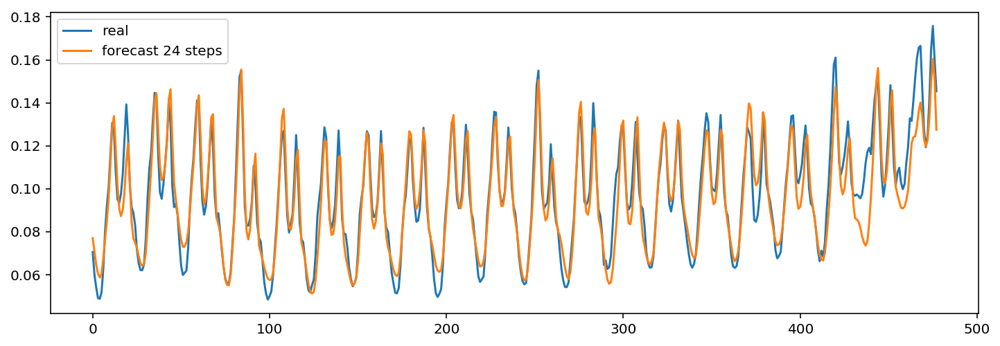

	 	 Forecasting a sample from Learning dataset


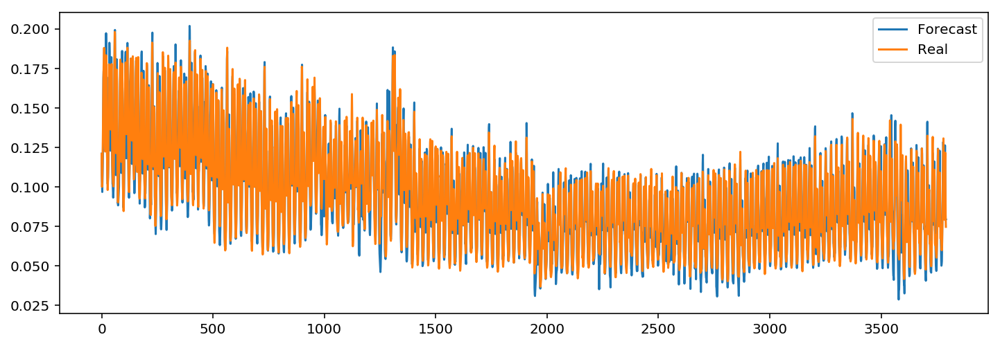

In [78]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[8] = MonthIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/summer/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 44
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.72287050809 
Daily Learning mean absolute percentage error of 158 days : 6.78059580205 
	 	 MAPError plot through Learning DataSet 


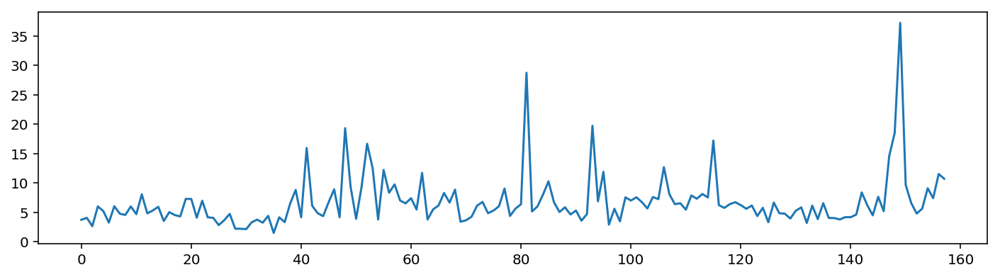

	 	 Test subset results
Test mean absolute percentage error per hour: 3.512672
Test mean absolute percentage error per day: 7.742280 
	 	 Validation Forecasting visualisation


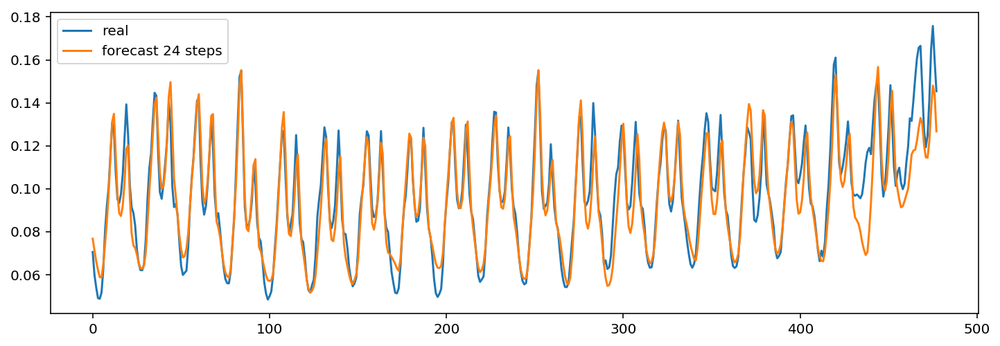

	 	 Forecasting a sample from Learning dataset


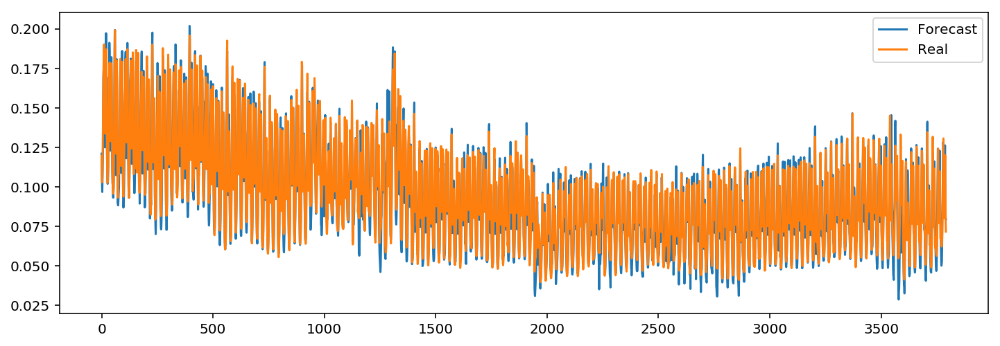

In [79]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[8] = MonthIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/summer/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 45
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 3.64665456493 
Daily Learning mean absolute percentage error of 158 days : 6.67114446737 
	 	 MAPError plot through Learning DataSet 


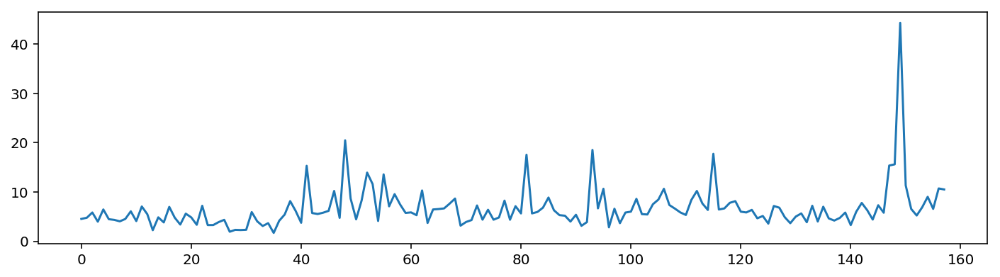

	 	 Test subset results
Test mean absolute percentage error per hour: 3.594405
Test mean absolute percentage error per day: 7.611603 
	 	 Validation Forecasting visualisation


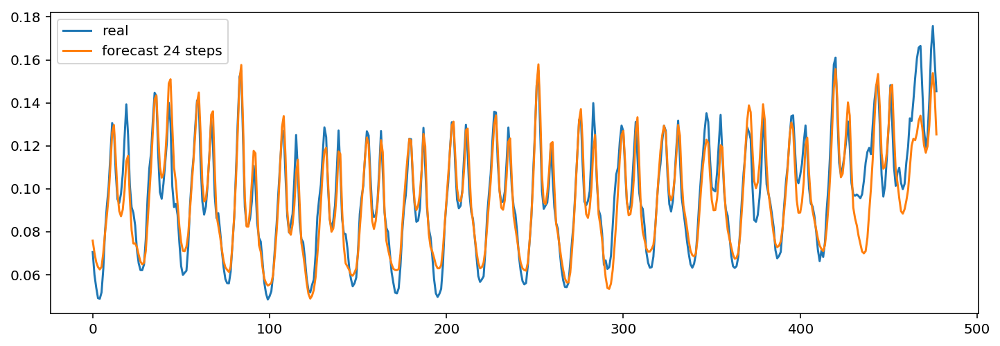

	 	 Forecasting a sample from Learning dataset


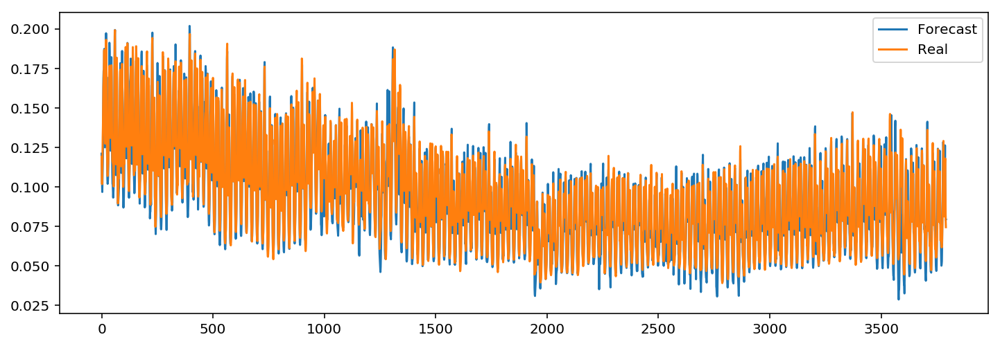

In [80]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[8] = MonthIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/summer/lstm_%d_%s'%((Model_ID),today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 46
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.88285002952 
Daily Learning mean absolute percentage error of 158 days : 6.0462961725 
	 	 MAPError plot through Learning DataSet 


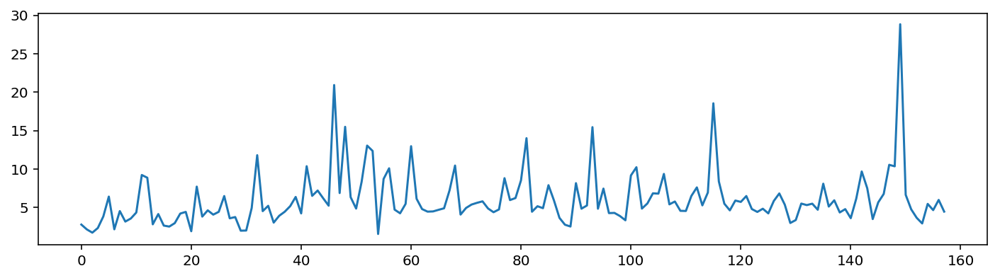

	 	 Test subset results
Test mean absolute percentage error per hour: 3.400686
Test mean absolute percentage error per day: 6.882048 
	 	 Validation Forecasting visualisation


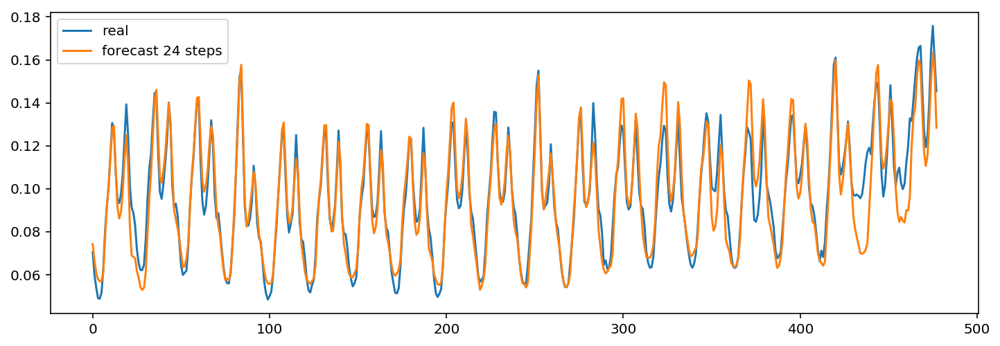

	 	 Forecasting a sample from Learning dataset


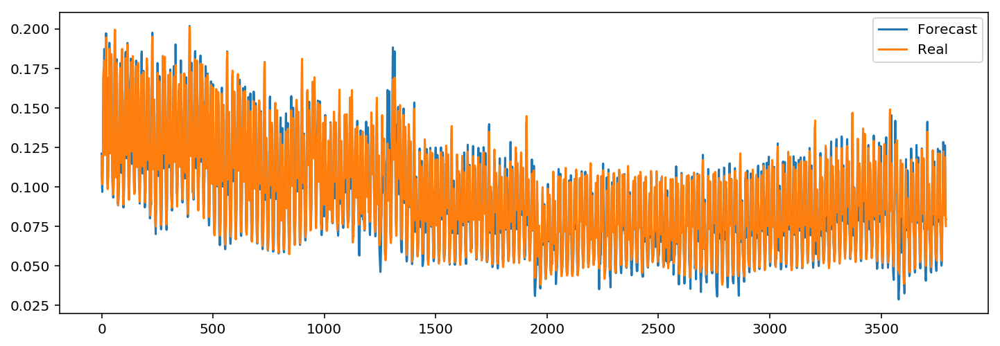

In [86]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


MLP_Model = ModelsList[1]
MLP_Model.save('Models/summer/lstm_%d_%s'%((1),today))

LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE


print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[1].index= range(ForecastingList[1].index.size)
plt.plot(ForecastingList[1].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[1].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()


In [6]:
def getForecastingResults2(learninginputs,learningoutputs,testinputs,testoutputs,Model, nbrInputs, IsShift,previoushour,season,timeSteps):
    
    testPeriod= 480
    
    predictionPeriod = learninginputs.index.size-testPeriod
    temp=learninginputs.iloc[:predictionPeriod-24].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod-24]

    
    
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    testPeriod= 480

    forecasting_history=pd.DataFrame(np.random.randn(dendi, 3),columns=['real', 'forecast 24 steps','forecast 1 step'],index=pd.date_range(dstart,freq='H',periods=478))
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
        forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]


    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)

    
    return forecasting_history

In [7]:
def getForecastingResults4( learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

    Model = Model
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningRMSE= rmse(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningRMSE= rmse(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning root mean square error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningRMSE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning root mean square error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningRMSE))
    
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestRMSE= rmse(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testRMSE= rmse(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)
    
    print('Test mean absolute error per hour: %f' %HtestRMSE)
    print('Test mean absolute error per day: %f ' %testRMSE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

-------Input preparation process complet-------
	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.88284996911 
Daily Learning mean absolute percentage error of 158 days : 5.78249160388 
Hourly Learning mean absolute error of 3792 hours : 0.00240999446221 
Daily Learning mean absolute error of 158 days : 0.0051353662204 
Hourly Learning root mean square error of 3792 hours : 0.0033960156814413786 
Daily Learning root mean square error of 158 days : 0.007172094783642724 
	 	 MAPError plot through Learning DataSet 


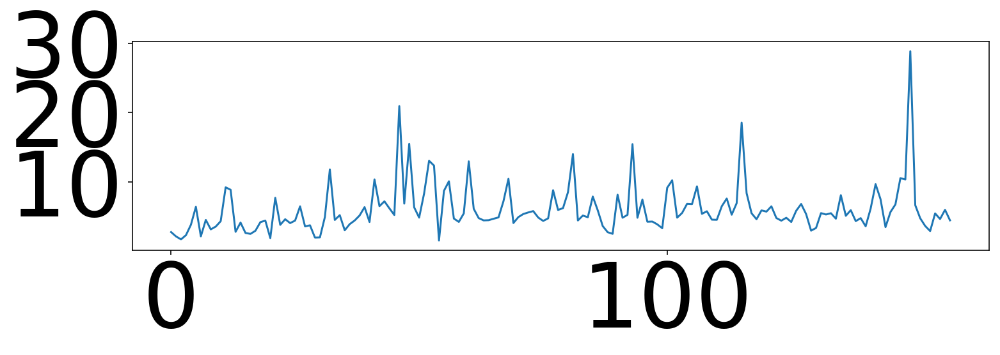

	 	 Test subset results
Test mean absolute percentage error per hour: 3.400685
Test mean absolute percentage error per day: 6.882034 
Test mean absolute error per hour: 0.003228
Test mean absolute error per day: 0.006246 
Test mean absolute error per hour: 0.004387
Test mean absolute error per day: 0.008748 
	 	 Validation Forecasting visualisation


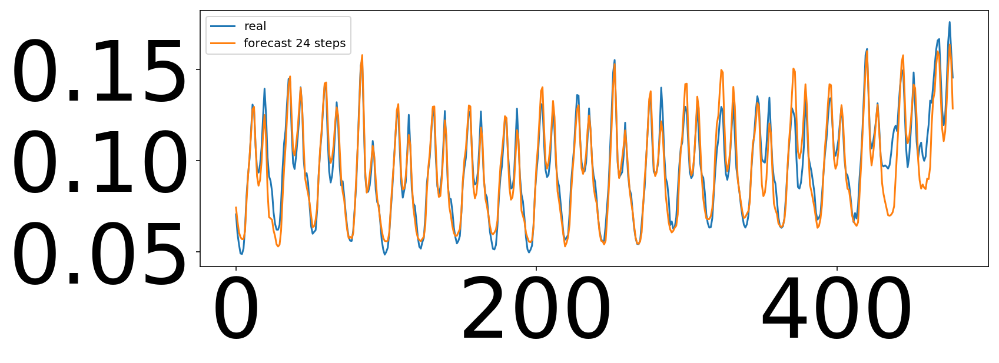

	 	 Test subset results
Test mean absolute percentage error per hour: 3.400685
Test mean absolute percentage error per day: 6.882034 


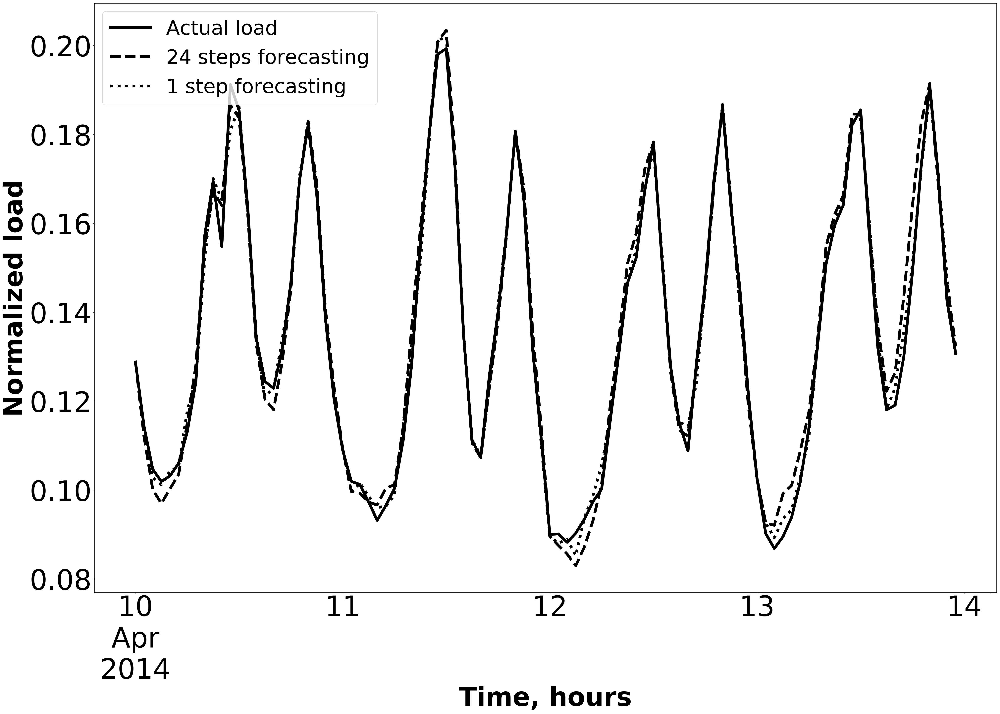

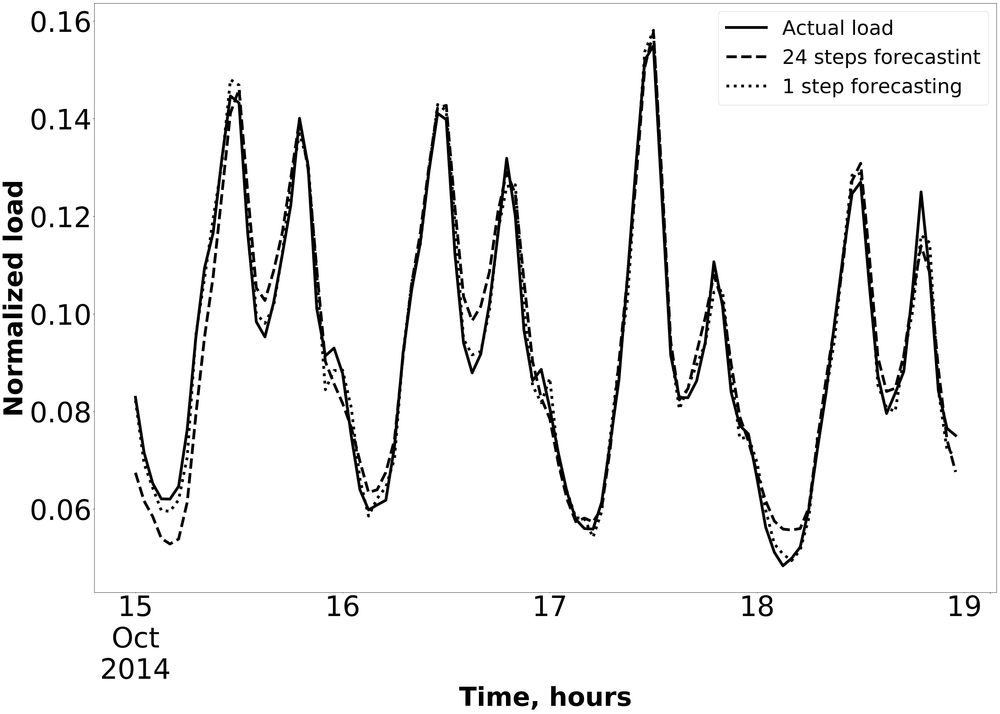

In [20]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = HourIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)


LSTM_Model = load_model('Models/summer/lstm_1_2018-07-22')

LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults4(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)


TestHourlyForecast = getForecastingResults2(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)

plt.rc('xtick', labelsize=70)    # fontsize of the tick labels
plt.rc('ytick', labelsize=70)

a1=1
b1=5

a2=1
b2=5

LearningDailyForecast.iloc[a1*24:b1*24,0].plot(label='Actual load',c='black',marker='.',linewidth=7,linestyle='-',figsize=(35,25))
LearningDailyForecast.iloc[a1*24:b1*24,1].plot(label='24 steps forecasting',c='black',linewidth=7,linestyle='--')
LearningDailyForecast.iloc[a1*24:b1*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')
plt.legend(fontsize=50, loc='best', borderaxespad=0.4)

plt.tight_layout()
plt.savefig('SummerLearning.pdf')

plt.show()


TestHourlyForecast.iloc[a2*24:b2*24,0].plot(label='Actual load',c='black',marker='.',linestyle='-',linewidth=7,figsize=(35,25))
TestHourlyForecast.iloc[a2*24:b2*24,1].plot(label='24 steps forecastint',c='black',linewidth=7,linestyle='--')
TestHourlyForecast.iloc[a2*24:b2*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.legend( fontsize= 50,loc='best', borderaxespad=0.4)
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')

plt.tight_layout()
plt.savefig('SummerTest.pdf')

plt.show()


	 	 learning subset results
Hourly Learning mean absolute percentage error of 3792 hours : 2.88285002952 
Daily Learning mean absolute percentage error of 158 days : 5.78249153444 
Hourly Learning mean absolute error of 3792 hours : 0.00240999427261 
Daily Learning mean absolute error of 158 days : 0.00513536542563 
	 	 MAPError plot through Learning DataSet 


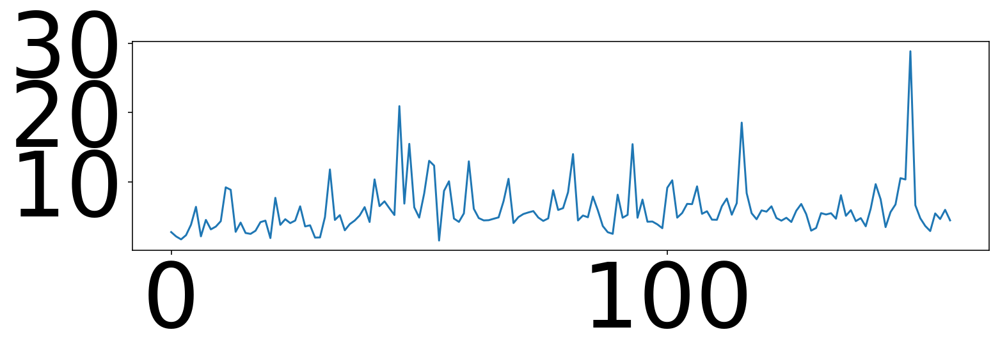

	 	 Test subset results
Test mean absolute percentage error per hour: 3.400686
Test mean absolute percentage error per day: 6.882048 
Test mean absolute error per hour: 0.003228
Test mean absolute error per day: 0.006246 
	 	 Validation Forecasting visualisation


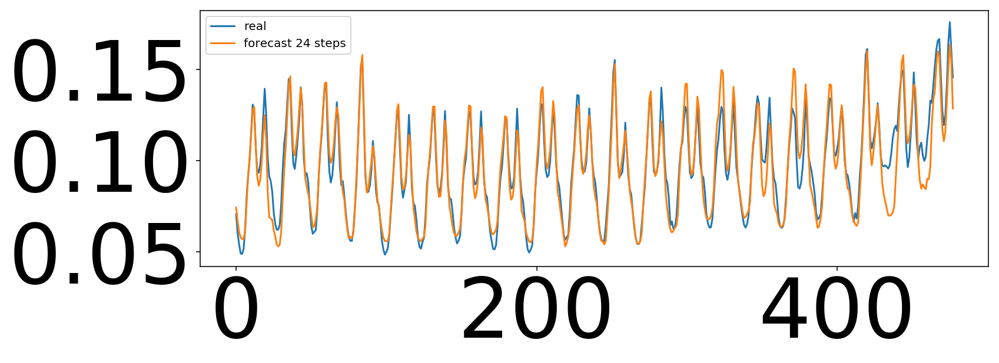

	 	 Forecasting a sample from Learning dataset


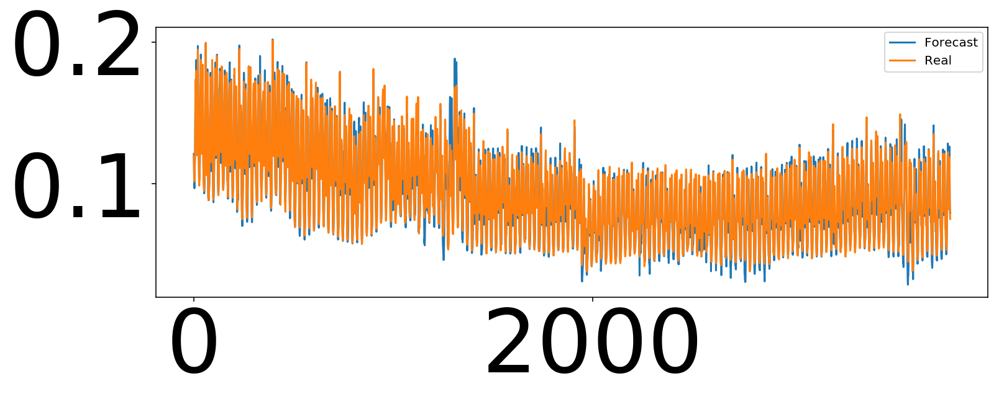

In [94]:
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[1].index= range(ForecastingList[1].index.size)
plt.plot(ForecastingList[1].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[1].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()